In [2]:
# Mount Google Drive.
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# Install packages.
from IPython.display import clear_output
!pip install captum opencv-python xmltodict
!pip install torch==1.8.0+cu111 torchvision==0.9.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html

# Imports general.
import sys
import gc
import warnings
import pathlib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torchvision
from torchvision import transforms
import captum
from captum.attr import *
import random
import os
import cv2
import PIL
from xml.etree import ElementTree
import xmltodict
import collections

# Import package.
path = "/content/drive/MyDrive/Projects"
sys.path.append(f'{path}/quantus')
import quantus

# Collect garbage.
gc.collect()
torch.cuda.empty_cache()

# Configs torch (read more on this cuda-related issue here: https://github.com/pytorch/pytorch/issues/45769).
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Notebook settings.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") 
#warnings.filterwarnings("ignore", category=UserWarning)
#warnings.filterwarnings("ignore", category=DeprecationWarning)
#warnings.filterwarnings("ignore", category=FutureWarning)

%load_ext autoreload
%autoreload 2
clear_output()

In [ ]:
!pip install numpy --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached numpy-1.21.6-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl (15.7 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.4 requires scikit-learn>=1.0.0, but you have scikit-learn 0.24.2 which is incompatible.
quantus 0.1.5 requires numpy==1.19.5, but you have numpy 1.21.6 which is incompatible.
pymc3 3.11.5 requires scipy<1.8.0,>=1.7.3, but you have scipy 1.5.4 which is incompatible.
gym 0.25.1 requires importlib-metadata>=4.8.0; python_version < "3.10", but you have importlib-metadata 4.2.0 which is incompatible.


## 1. Preliminaries

### 1.1 Load datasets

We will then load a batch of input, output pairs that we generate explanations for, then to evaluate.

In [ ]:
!wget https://s3.amazonaws.com/fast-ai-imageclas/imagenette2-320.tgz
!tar zxf imagenette2-320.tgz
clear_output()

In [ ]:
!ls imagenette2-320/train/n01440764 | head

ILSVRC2012_val_00000293.JPEG
ILSVRC2012_val_00002138.JPEG
ILSVRC2012_val_00003014.JPEG
ILSVRC2012_val_00006697.JPEG
ILSVRC2012_val_00007197.JPEG
ILSVRC2012_val_00009346.JPEG
ILSVRC2012_val_00009379.JPEG
ILSVRC2012_val_00009396.JPEG
ILSVRC2012_val_00010306.JPEG
ILSVRC2012_val_00011233.JPEG


In [ ]:
# For the localisation metrics we need to load a dataset that has ground truth masks.

def load_sample(path: str) -> dict:
    """Read data as image and path. """
    return PIL.Image.open(path).convert("RGB")


class CustomTransform(torch.nn.Module):
    """Custom transformation to handle image processing and binary mask processing simultaneously. """
    
    image_transform = transforms.Compose([transforms.Resize((224, 224)),
                                          transforms.ToTensor(),
                                          transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])
    def __init__(self, path):
        super().__init__()
        self.path = path
        
    def __call__(self, img):
        return self.image_transform(img)


In [ ]:
import ast
!wget https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt -O class_names.txt
class_name_dict = None
with open('class_names.txt') as fIn:
  class_name_dict = ast.literal_eval(fIn.read())

--2022-08-25 10:46:54--  https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt
Resolving gist.githubusercontent.com (gist.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to gist.githubusercontent.com (gist.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30564 (30K) [text/plain]
Saving to: ‘class_names.txt’

class_names.txt     100%[===================>]  29.85K  --.-KB/s    in 0s      

2022-08-25 10:46:54 (131 MB/s) - ‘class_names.txt’ saved [30564/30564]



In [ ]:
class_dict = {'n01440764':0, 'n02102040':217, 'n02979186':481, 'n03000684':491, 'n03028079':497, 'n03394916':566, 'n03417042':569, 'n03425413':571, 'n03445777':574, 'n03888257':701}
class_dirs = list(class_dict.keys())

def verify_file(path):
  return path[-5:]==".JPEG"
#extensions=("JPEG",),

def transform_labels(l):
  new_l = class_dict[class_dirs[l]]
  #print(new_l)
  return new_l

# Load test data and make loaders.
path_data = 'imagenette2-320/train'
dataset = torchvision.datasets.DatasetFolder(path_data, 
                                             loader=load_sample, 
                                             is_valid_file=verify_file,
                                             transform=CustomTransform(path=path_data),
                                             target_transform=transform_labels)
test_loader = torch.utils.data.DataLoader(dataset, shuffle=True, batch_size=24)

In [ ]:
# Load a batch of inputs, segmentation masks and outputs to use for evaluation.
x_batch, y_batch = iter(test_loader).next()
x_batch_device, y_batch_device = x_batch.to(device), y_batch.to(device)

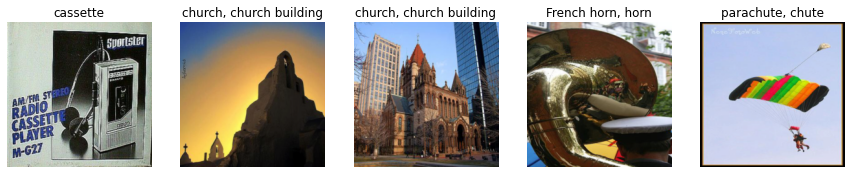

In [ ]:
# Plot some inputs!

nr_images = 5
fig, axes = plt.subplots(nrows=1, ncols=nr_images, figsize=(nr_images*3, int(nr_images*2/3)))
for i in range(nr_images):
    axes[i].imshow((np.moveaxis(quantus.denormalise(x_batch[i].numpy()), 0, -1) * 255).astype(np.uint8), vmin=0.0, vmax=1.0, cmap="gray")
    axes[i].title.set_text(f"{class_name_dict[y_batch[i].item()]}")
    axes[i].axis("off")
plt.show()

### 1.2 Load a pre-trained model

In this example we load a pre-trained ResNet-18 model but it goes without saying that any model works.

In [ ]:
def evaluate_model(model, data, device):
    """Evaluate accuracy of torch model."""
    model.eval()
    logits = torch.Tensor().to(device)
    targets = torch.LongTensor().to(device)

    with torch.no_grad():
        for images, labels in data:
            images, labels = images.to(device), labels.to(device)
            logits = torch.cat([logits, model(images)])
            targets = torch.cat([targets, labels])
            
    return np.mean(np.argmax(logits.cpu().numpy(), axis=1) == targets.cpu().numpy())
    
# Load pre-trained ResNet18 model.
model = torchvision.models.resnet18(pretrained=True)
model = model.to(device)

# Evaluate model performance.
#print(f"\nModel test accuracy: {(100 * evaluate_model(model.to(device), test_loader, device)):.2f}%")

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

### 1.3 Generate attribution-based explanations

There exist multiple ways to generate explanations for neural network models e.g., using `captum` or `innvestigate` libraries. In this example, we rely on the `quantus.explain` functionality (a simple wrapper around `captum`) however use whatever approach or library you'd like to create your explanations.

**Requirements.**

* **Data type.** Similar to the x-y pairs, the attributions should also be of type `np.ndarray`
* **Shape.** Sharing all the same dimensions as the input (expect for nr_channels which for explanations is equal to 1). For example, if x_batch is of size (128, 3, 224, 224) then the attributions should be of size (128, 1, 224, 224).

#GAUSSIAN

This cell defines a function that builds a layer that performs Gaussian blurring

In [ ]:
import math
from torch import nn

def get_gaussian_conv2d(kernel_size = 15, sigma = 3, channels = 3):
  # https://discuss.pytorch.org/t/is-there-anyway-to-do-gaussian-filtering-for-an-image-2d-3d-in-pytorch/12351/3
  # Create a x, y coordinate grid of shape (kernel_size, kernel_size, 2)
  x_cord = torch.arange(kernel_size)
  x_grid = x_cord.repeat(kernel_size).view(kernel_size, kernel_size)
  y_grid = x_grid.t()
  xy_grid = torch.stack([x_grid, y_grid], dim=-1)

  mean = (kernel_size - 1)/2.
  variance = sigma**2.

  # Calculate the 2-dimensional gaussian kernel which is
  # the product of two gaussian distributions for two different
  # variables (in this case called x and y)
  gaussian_kernel = (1./(2.*math.pi*variance)) *\
                    torch.exp(
                        -torch.sum((xy_grid - mean)**2., dim=-1) /\
                        (2*variance)
                    )
  # Make sure sum of values in gaussian kernel equals 1.
  gaussian_kernel = gaussian_kernel / torch.sum(gaussian_kernel)

  # Reshape to 2d depthwise convolutional weight
  gaussian_kernel = gaussian_kernel.view(1, 1, kernel_size, kernel_size)
  gaussian_kernel = gaussian_kernel.repeat(channels, 1, 1, 1)

  #print(gaussian_kernel)
  gaussian_filter = nn.Conv2d(in_channels=channels, out_channels=channels,
                              kernel_size=kernel_size, groups=channels, padding=kernel_size//2, bias=False)

  gaussian_filter.weight.data = gaussian_kernel
  gaussian_filter.weight.requires_grad = False
  return gaussian_filter

In [ ]:
def get_ranked_features(attributions, reverse=False):
  ranked_atributions = []
  for i in range(attributions.shape[1]):
    for j in range(attributions.shape[2]):
      ranked_atributions.append([attributions[0,i,j],i,j])
  ranked_atributions.sort(reverse=reverse)
  ranked_atributions = np.array(ranked_atributions)
  positions = np.array(ranked_atributions[:,1:],dtype=int)
  ranked_atributions = np.array(ranked_atributions[:,0])
  return ranked_atributions, positions

def create_numpy_mask(image, ranked_positions, fraction):
  mask_np = np.zeros(shape=image.shape[1:], dtype=np.float32)
  threshold = int(ranked_positions.shape[0]*fraction)
  mask_np[ranked_positions[:threshold,0], ranked_positions[:threshold,1]] = 1
  return mask_np

def get_masked_images(num_masks, image, alternative, positions):
  masks_numpy = np.zeros(shape=(num_masks, 1, image.shape[1], image.shape[2]), dtype=np.float32)
  for i in range(num_masks):
    masks_numpy[i,0] = create_numpy_mask(image, positions, i/num_masks)
  masks = torch.from_numpy(masks_numpy)
  images_masked = (image*masks) + (alternative*(1-masks))
  return images_masked

def get_randomly_masked_images(num_masks, image, alternative):
  width = image.shape[1]
  height = image.shape[2]
  masks_numpy = np.zeros(shape=(num_masks, 1, width, height), dtype=np.float32)
  mask_np = np.random.uniform(size=width*height).reshape((width, height))
  for i in range(num_masks):
    masks_numpy[i,0] = mask_np<i/num_masks
  masks = torch.from_numpy(masks_numpy)
  images_masked = (image*masks) + (alternative*(1-masks))
  return images_masked

def get_class_logits_for_masked_images(images_masked, model, class_num):
  with torch.no_grad():
    images = images_masked.to(device)
    logits = model(images).to('cpu').numpy()
  return logits[:,class_num],np.equal(np.argmax(logits, axis=1),class_num)



In [ ]:
quantus.AVAILABLE_XAI_METHODS

{'Control Var. Constant',
 'Control Var. Random Uniform',
 'Control Var. Sobel Filter',
 'FeatureAblation',
 'GradCam',
 'Gradient',
 'GradientShap',
 'InputXGradient',
 'IntegratedGradients',
 'Occlusion',
 'Saliency'}

Doing item 1 of 24 with IntegratedGradients


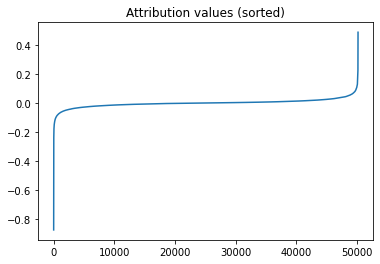

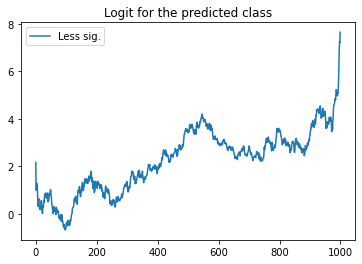

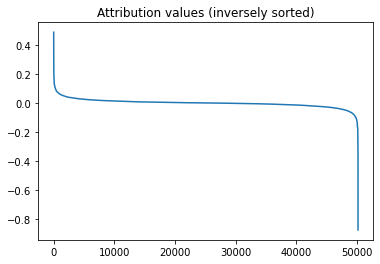

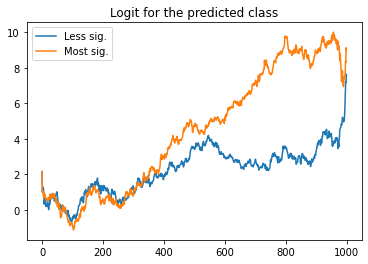

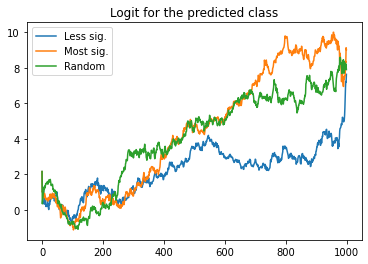

Doing item 2 of 24 with IntegratedGradients


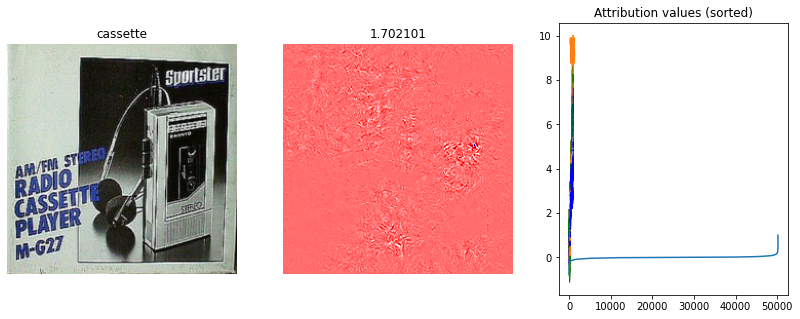

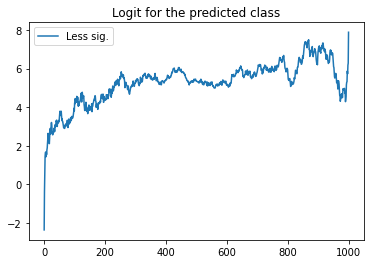

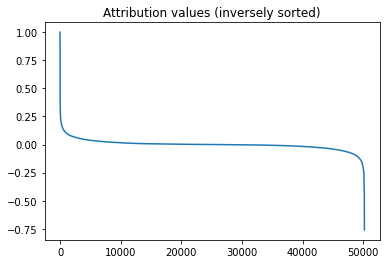

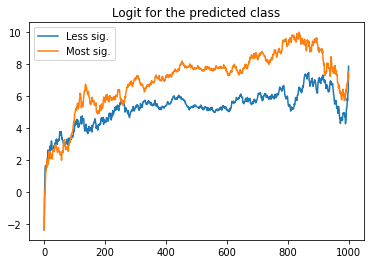

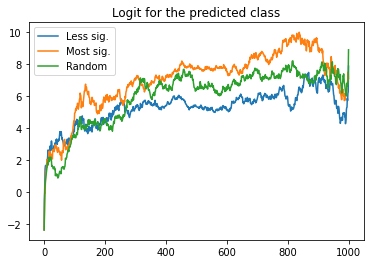

Doing item 3 of 24 with IntegratedGradients


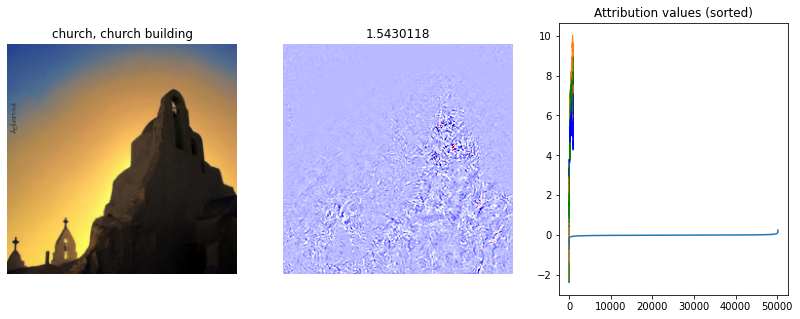

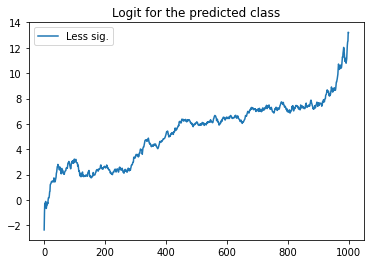

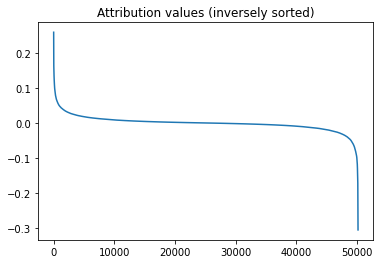

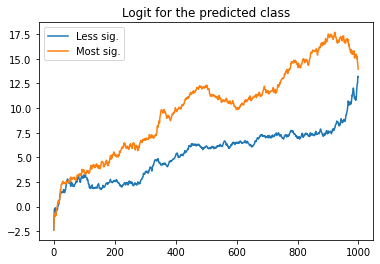

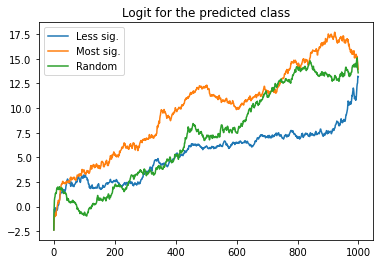

Doing item 4 of 24 with IntegratedGradients


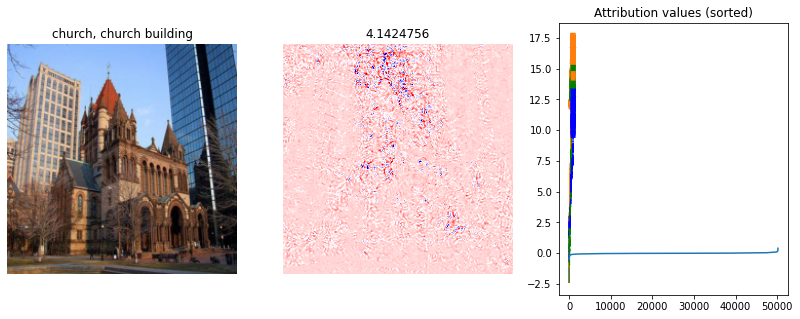

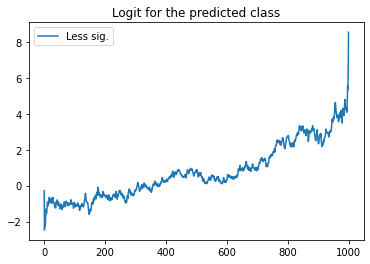

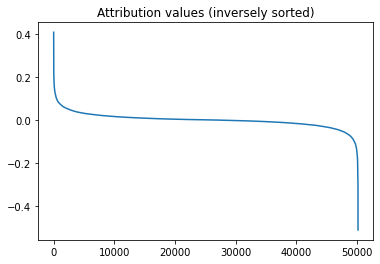

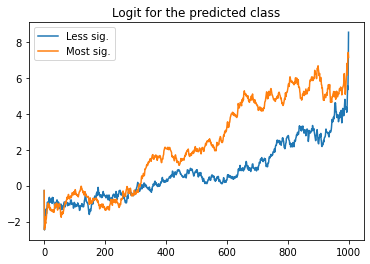

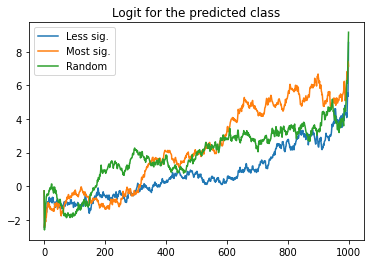

Doing item 5 of 24 with IntegratedGradients


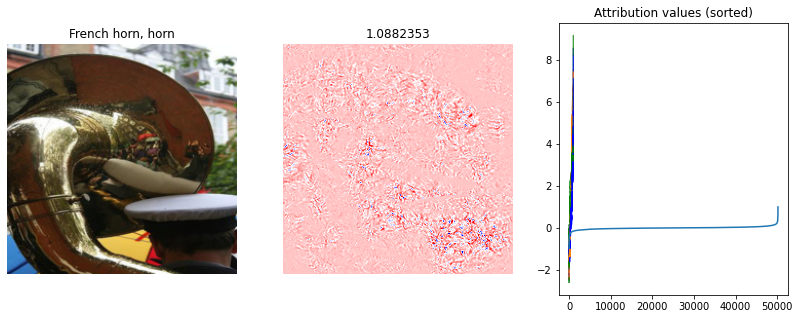

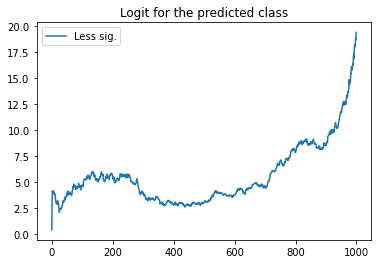

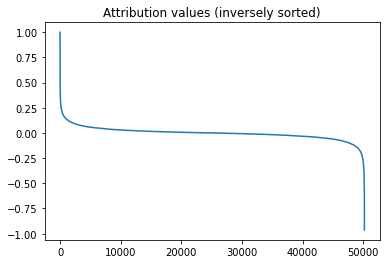

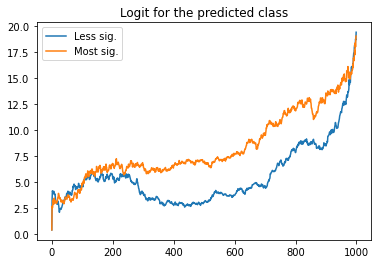

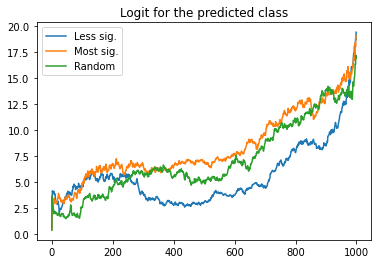

Doing item 6 of 24 with IntegratedGradients


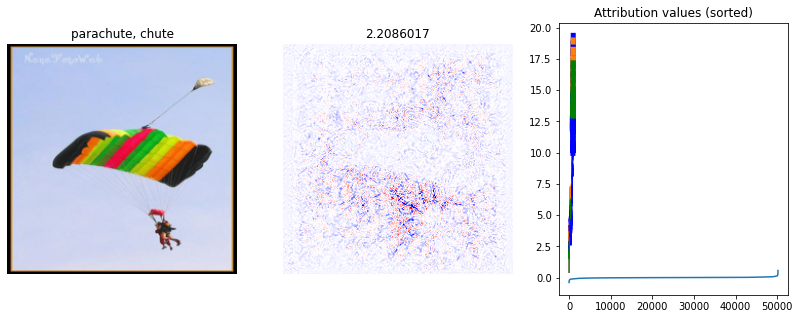

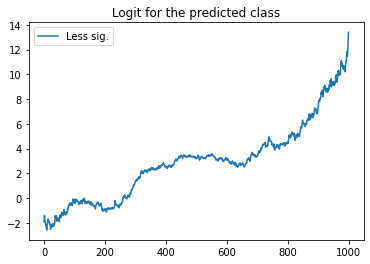

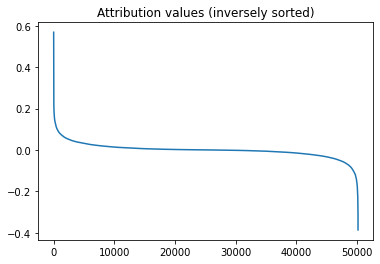

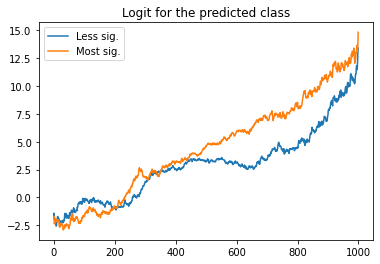

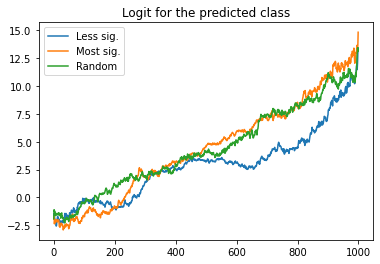

Doing item 7 of 24 with IntegratedGradients


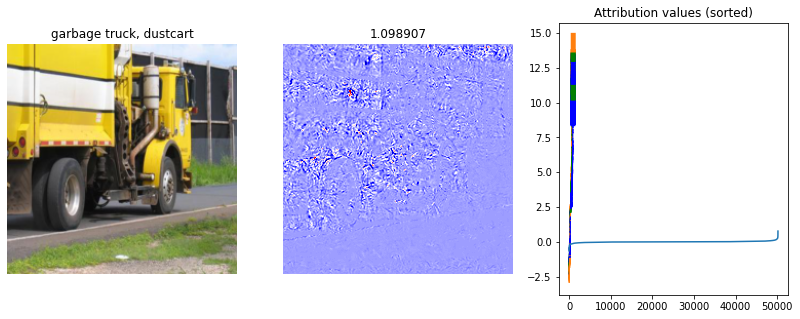

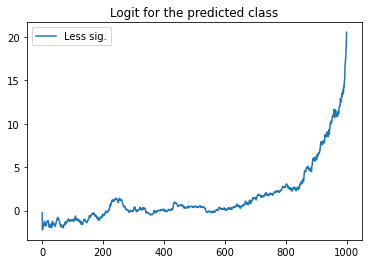

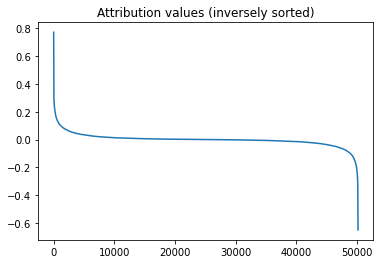

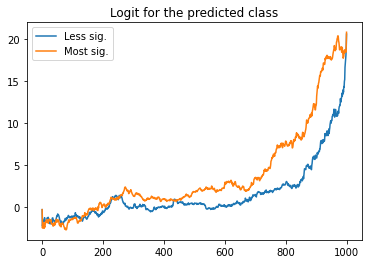

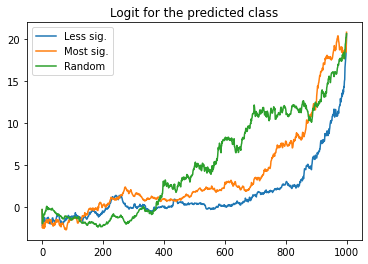

Doing item 8 of 24 with IntegratedGradients


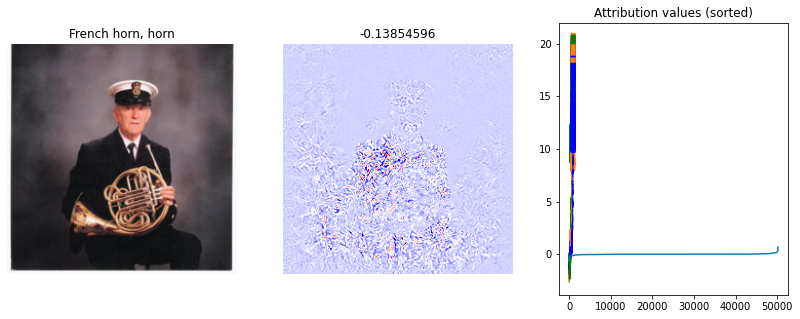

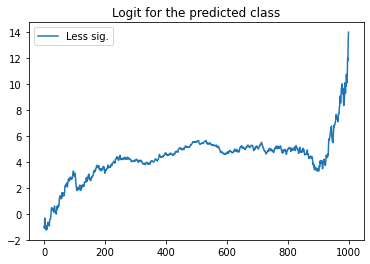

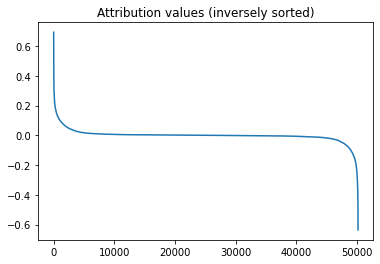

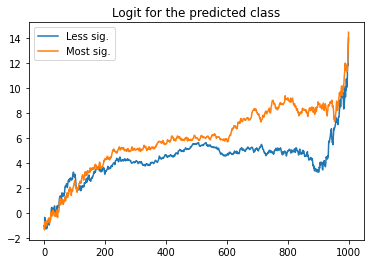

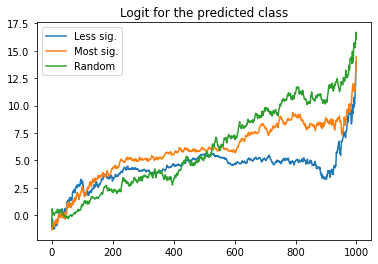

Doing item 9 of 24 with IntegratedGradients


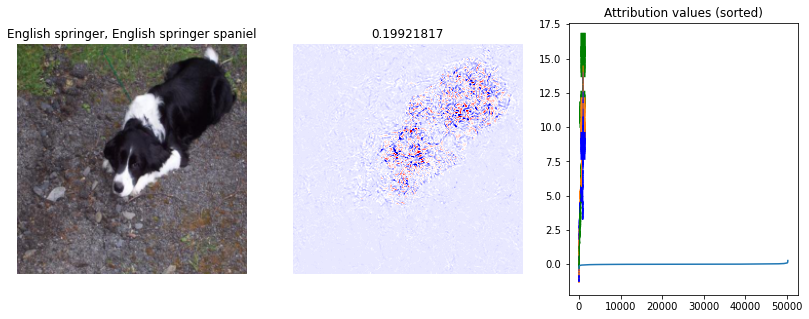

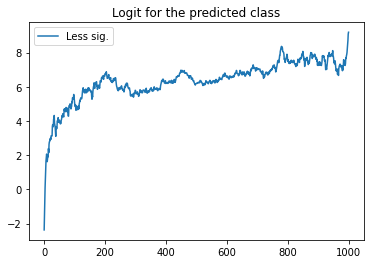

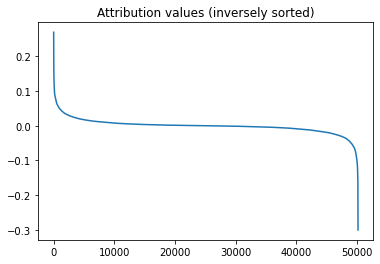

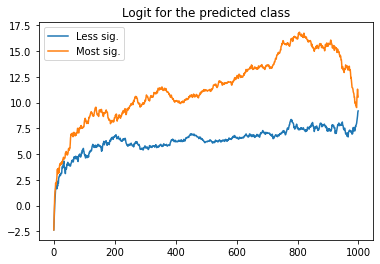

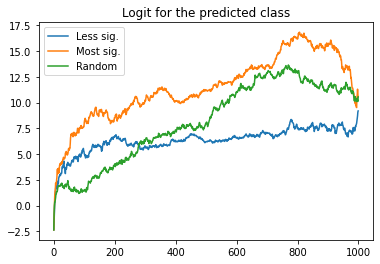

Doing item 10 of 24 with IntegratedGradients


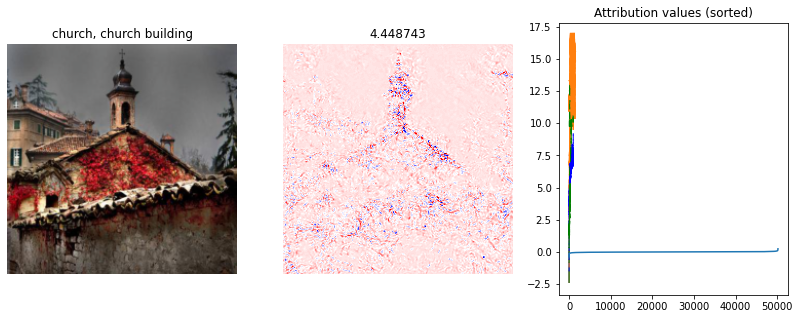

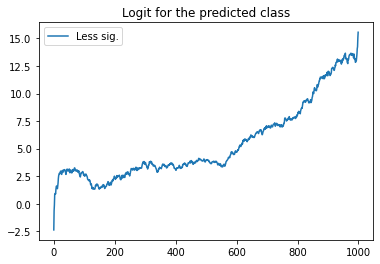

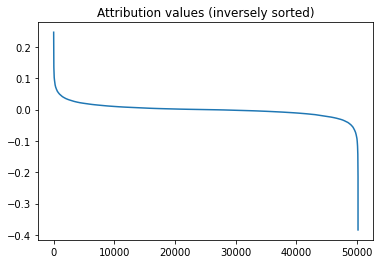

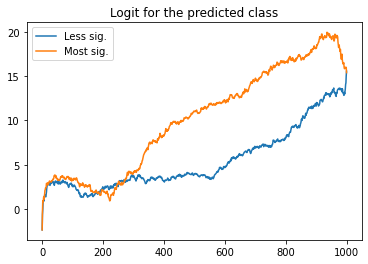

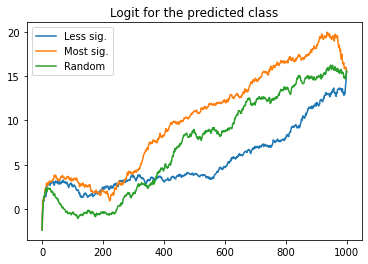

Doing item 11 of 24 with IntegratedGradients


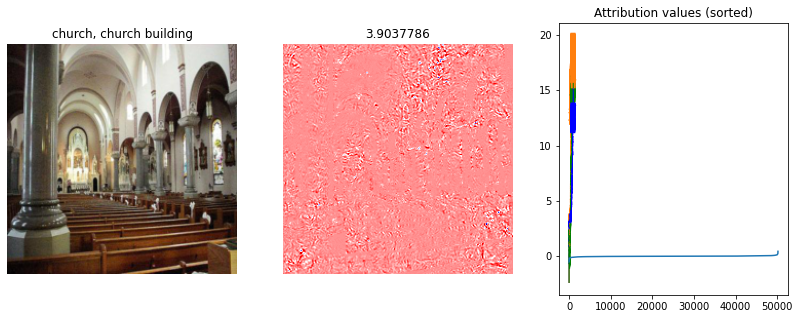

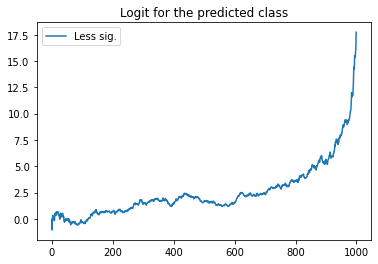

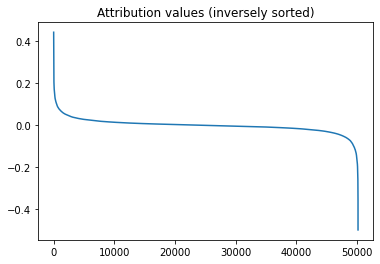

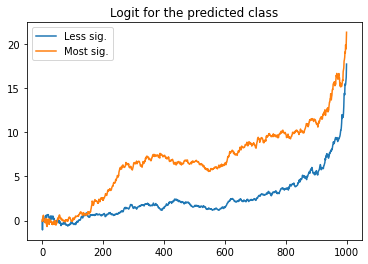

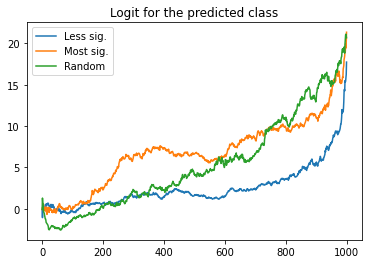

Doing item 12 of 24 with IntegratedGradients


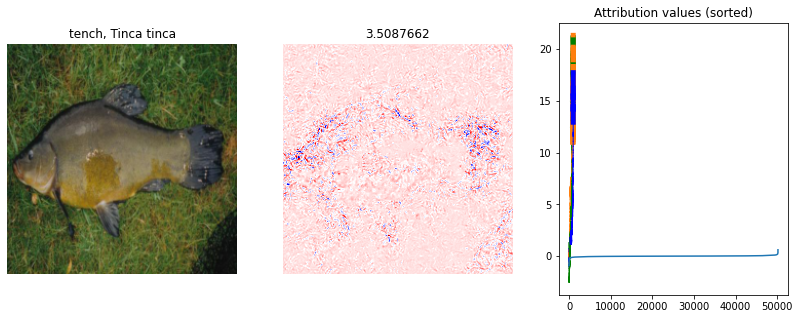

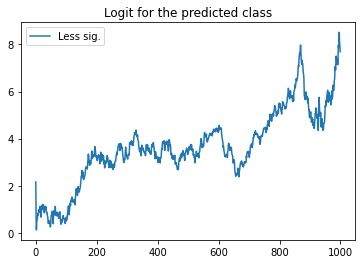

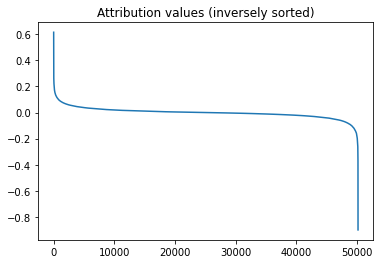

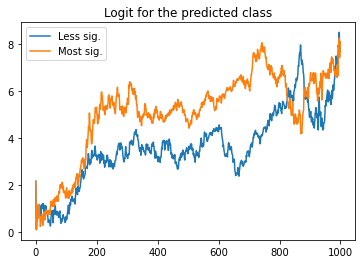

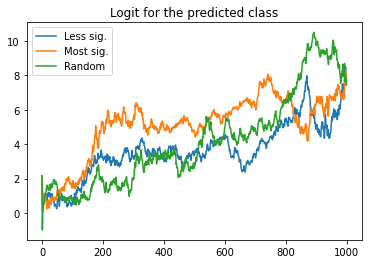

Doing item 13 of 24 with IntegratedGradients


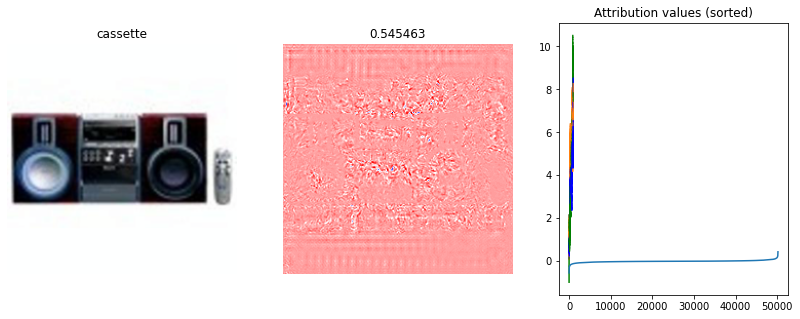

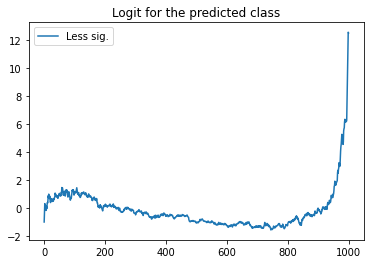

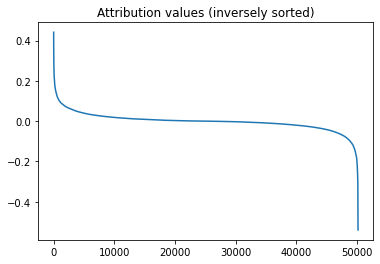

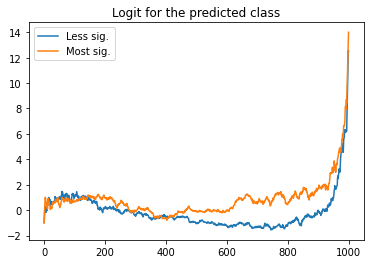

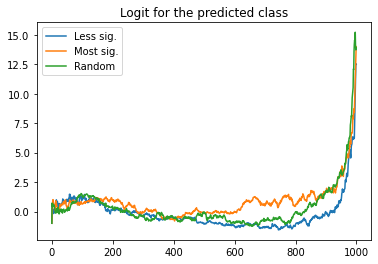

Doing item 14 of 24 with IntegratedGradients


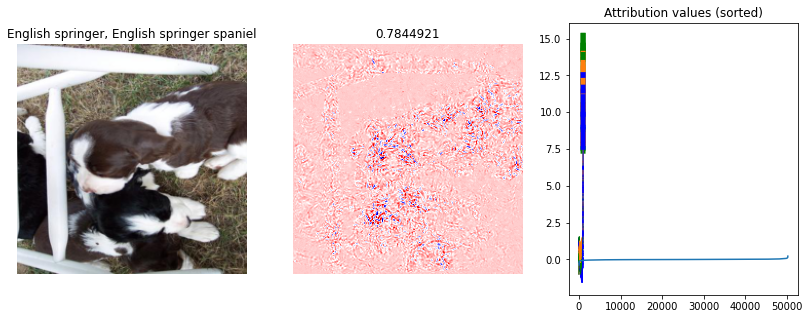

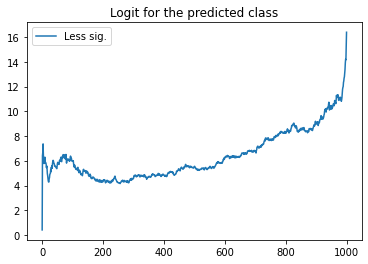

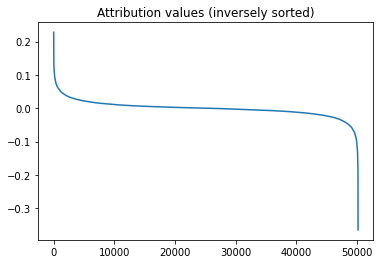

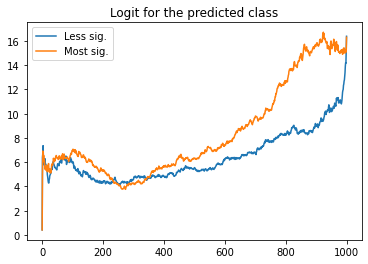

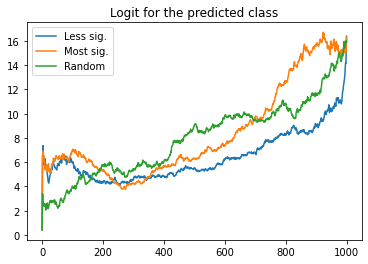

Doing item 15 of 24 with IntegratedGradients


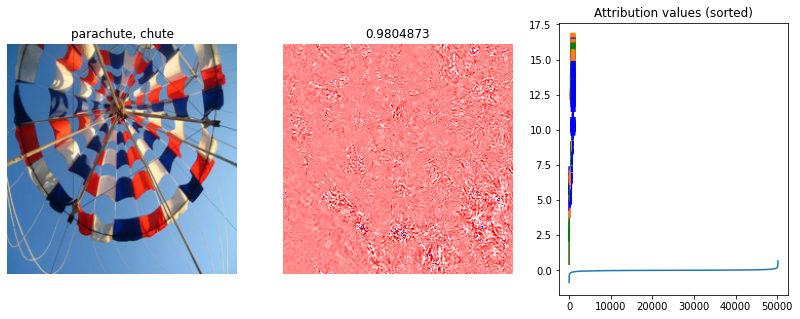

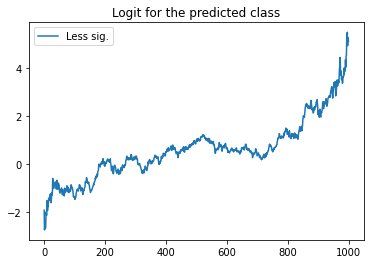

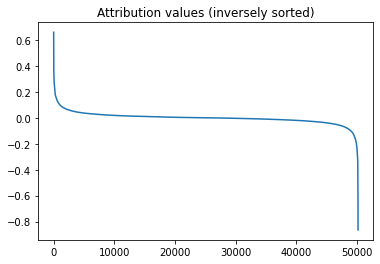

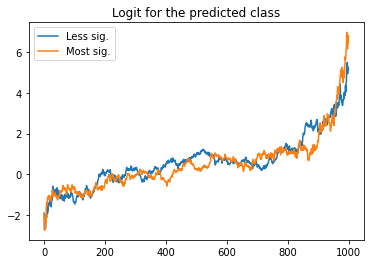

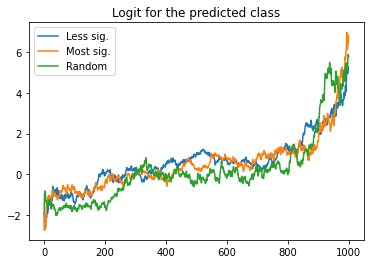

Doing item 16 of 24 with IntegratedGradients


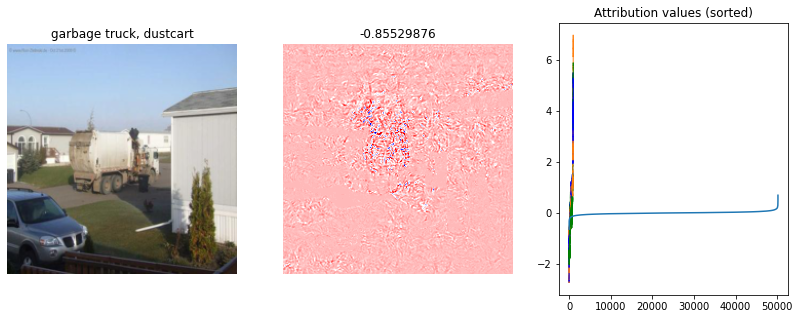

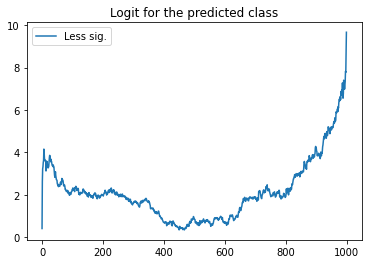

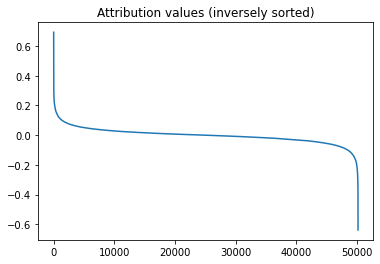

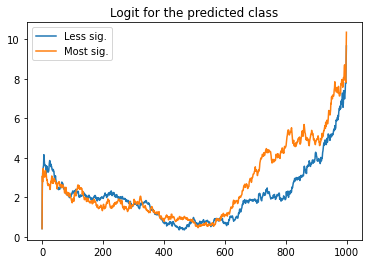

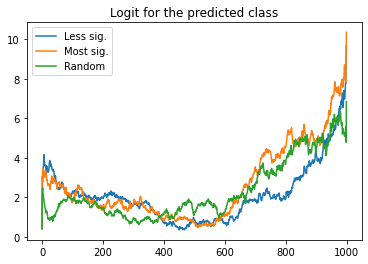

Doing item 17 of 24 with IntegratedGradients


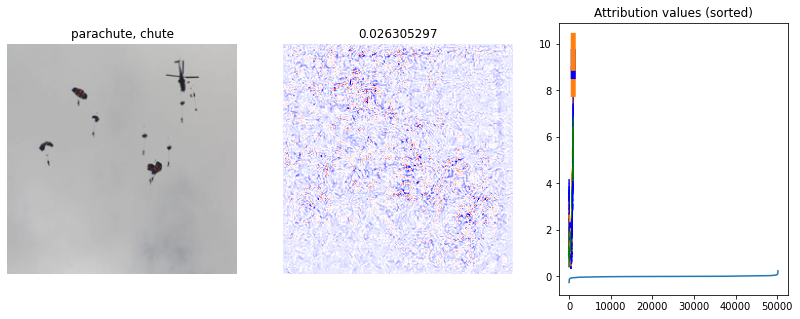

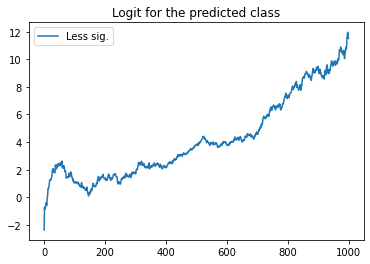

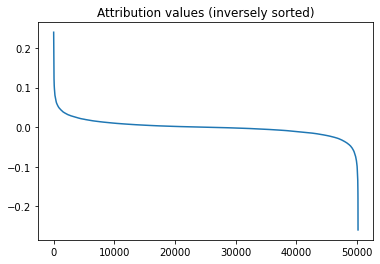

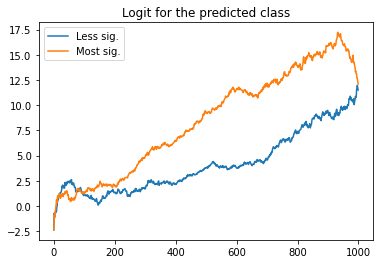

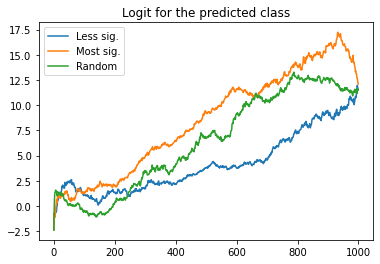

Doing item 18 of 24 with IntegratedGradients


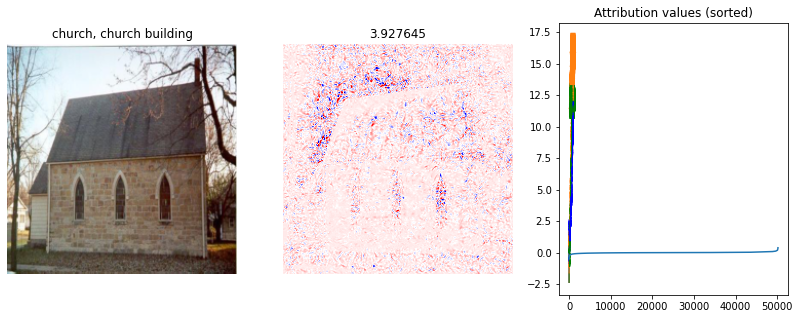

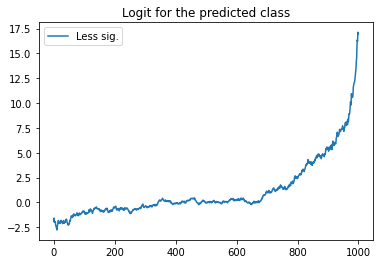

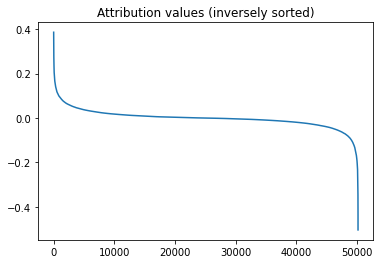

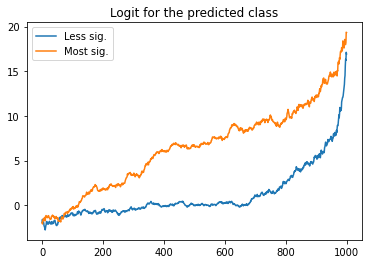

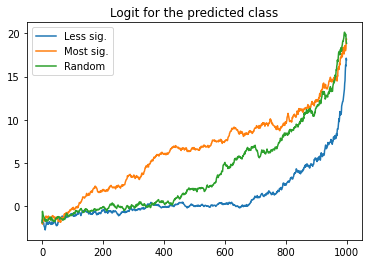

Doing item 19 of 24 with IntegratedGradients


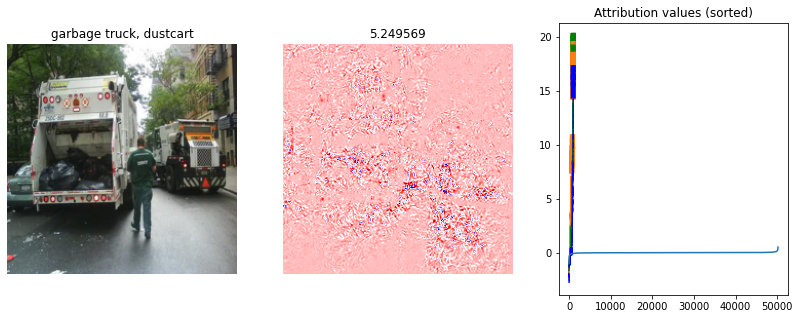

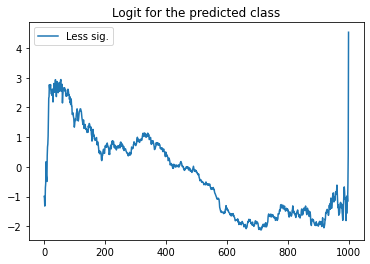

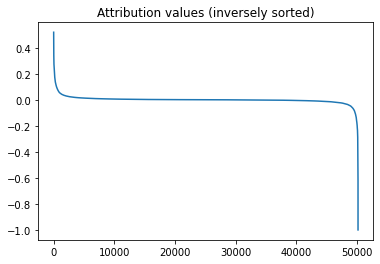

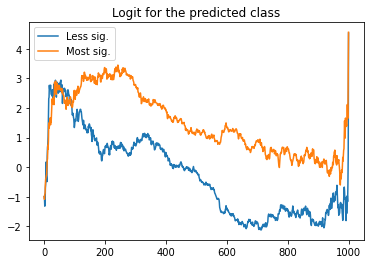

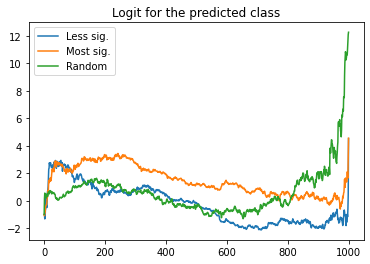

Doing item 20 of 24 with IntegratedGradients


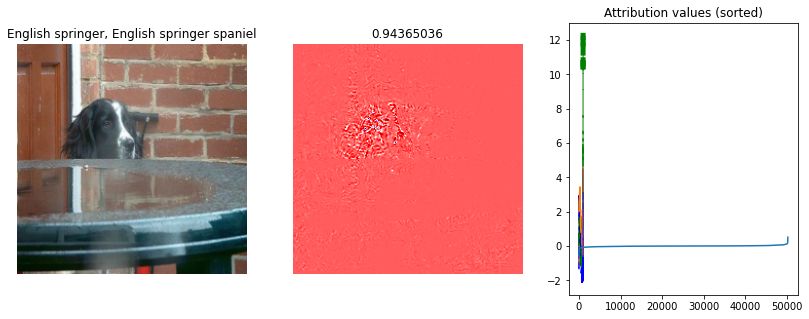

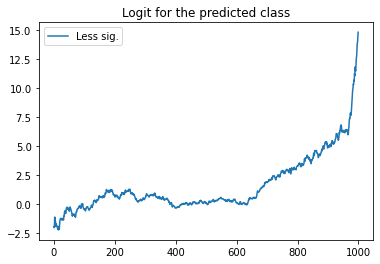

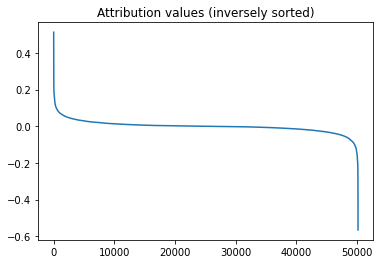

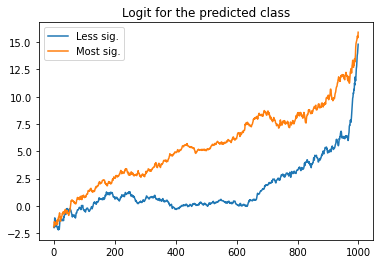

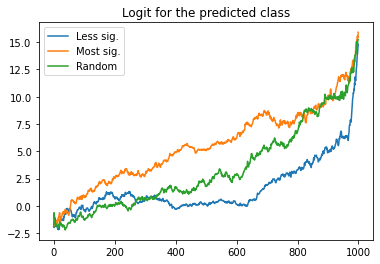

Doing item 21 of 24 with IntegratedGradients


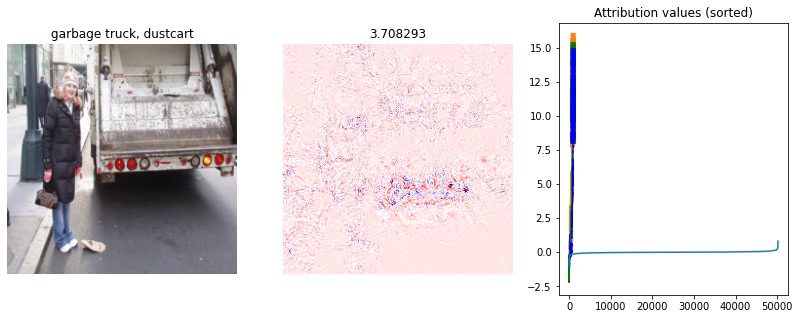

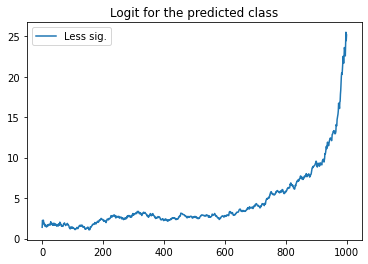

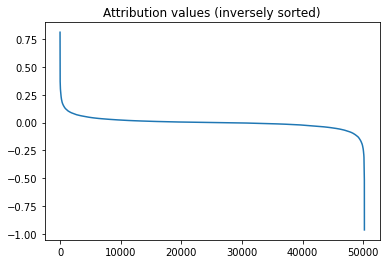

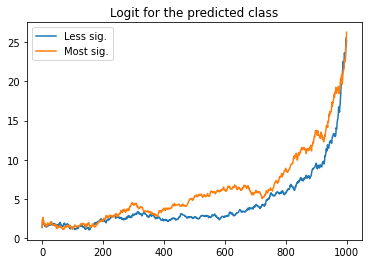

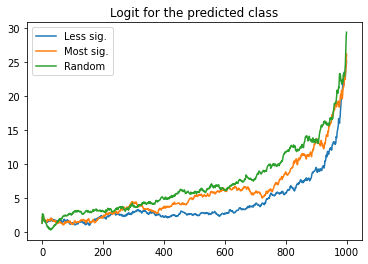

Doing item 22 of 24 with IntegratedGradients


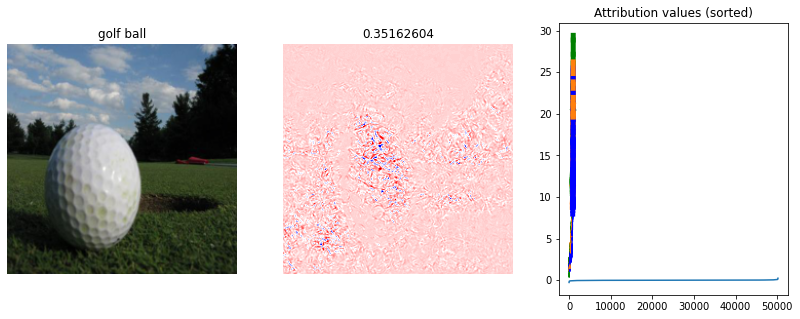

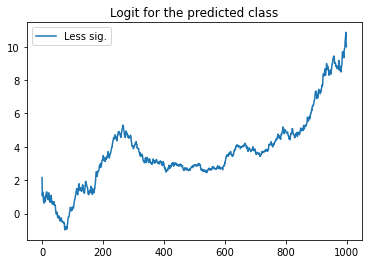

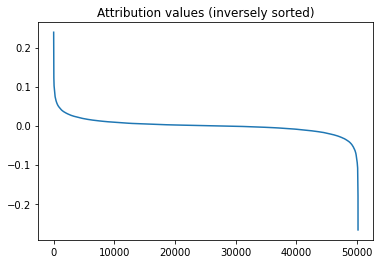

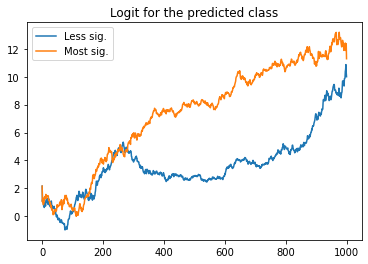

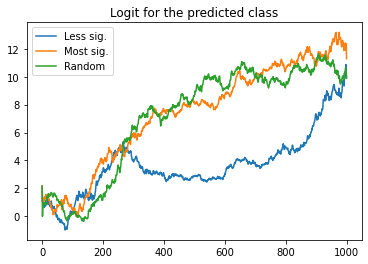

Doing item 23 of 24 with IntegratedGradients


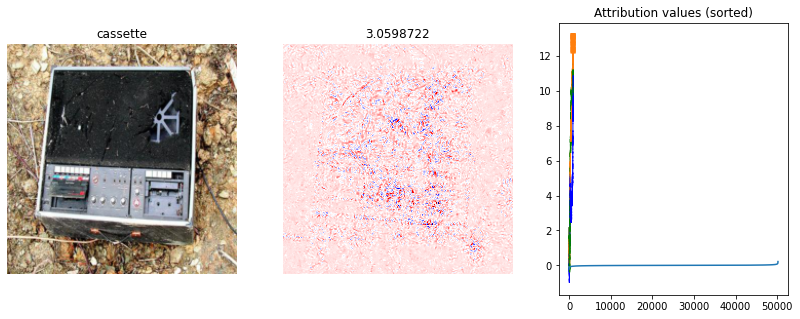

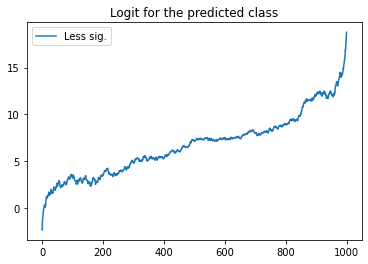

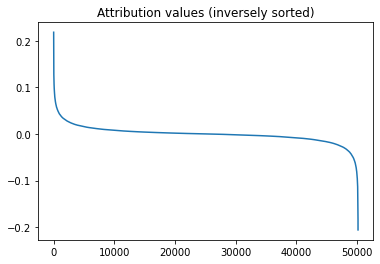

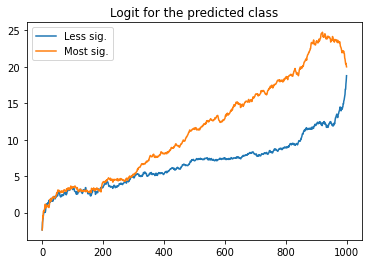

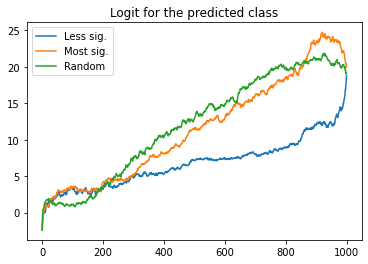

Doing item 24 of 24 with IntegratedGradients


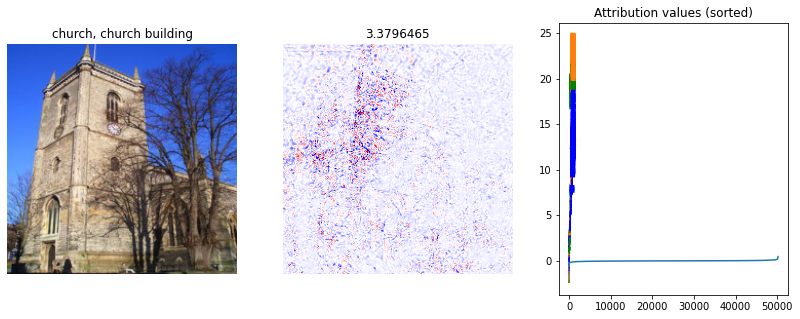

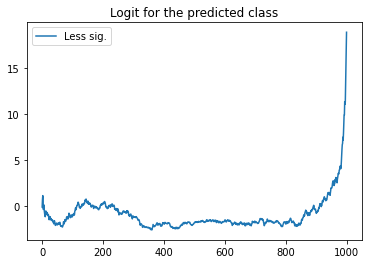

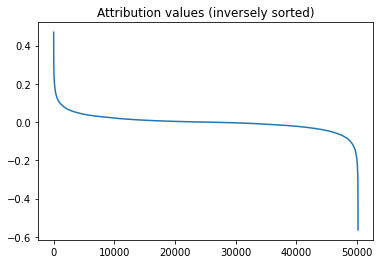

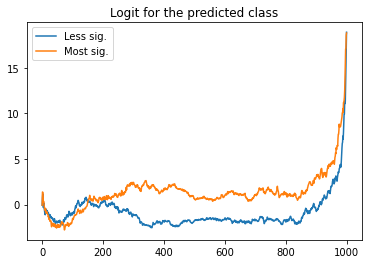

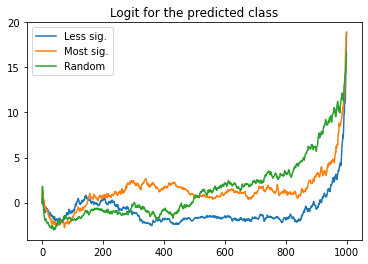

Doing item 1 of 24 with Saliency


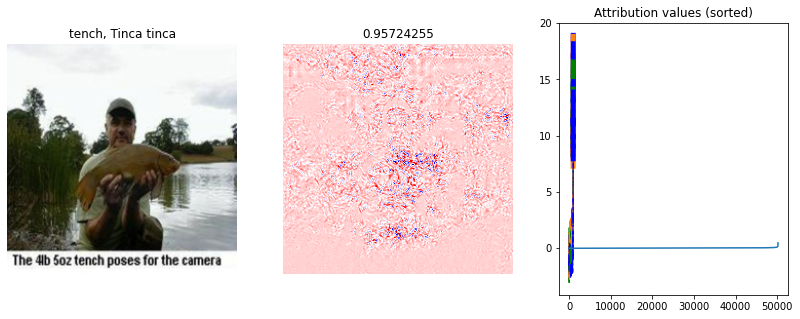

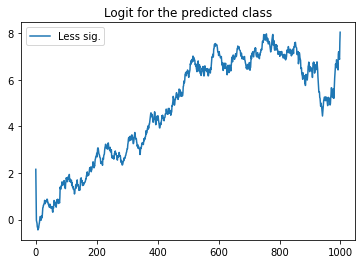

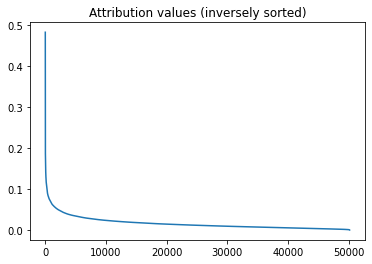

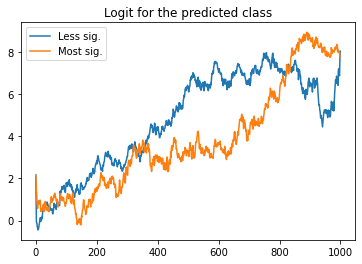

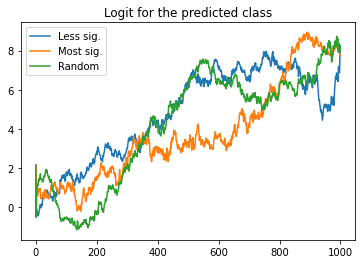

Doing item 2 of 24 with Saliency


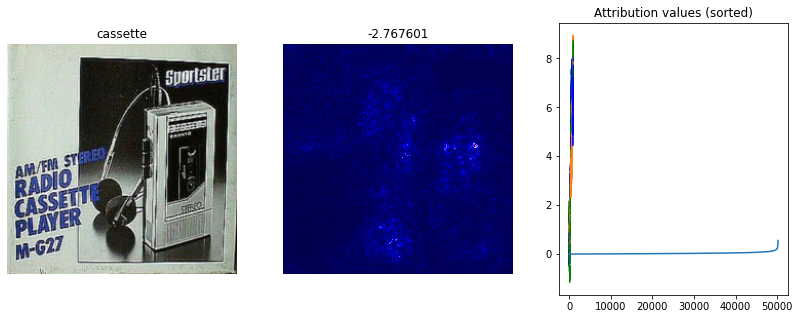

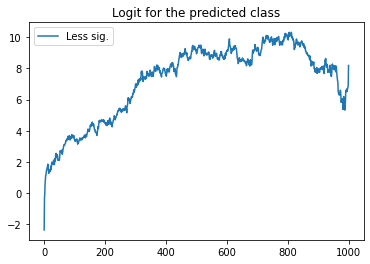

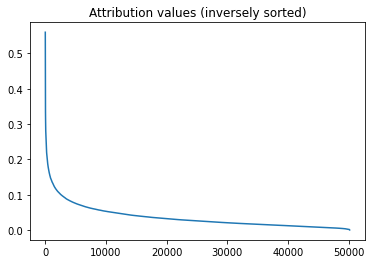

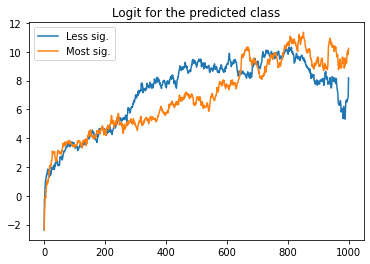

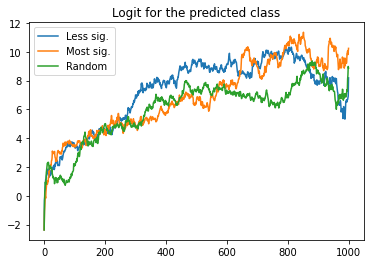

Doing item 3 of 24 with Saliency


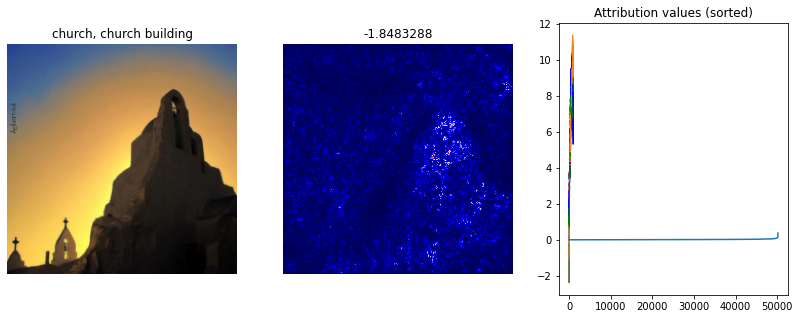

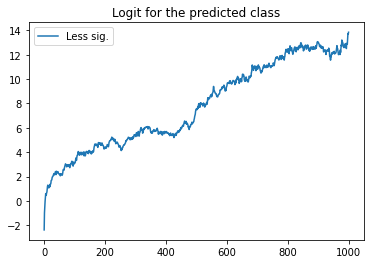

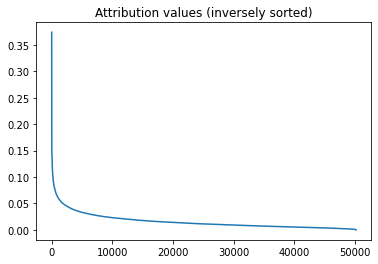

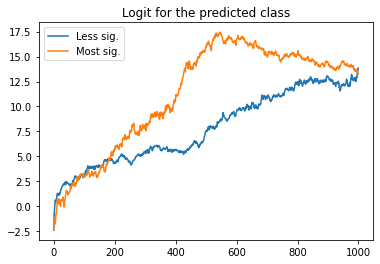

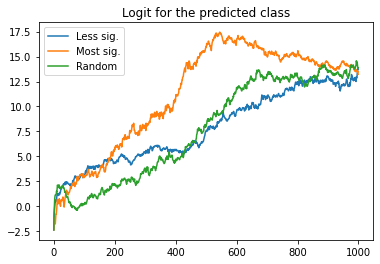

Doing item 4 of 24 with Saliency


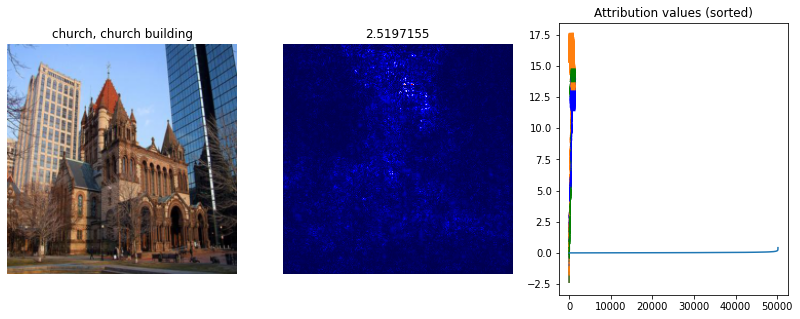

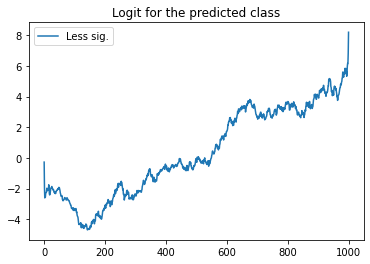

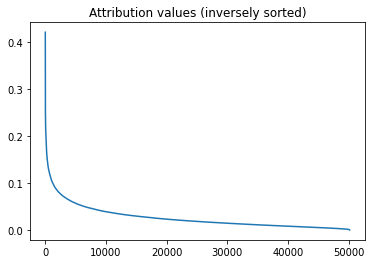

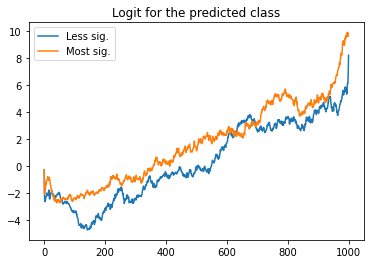

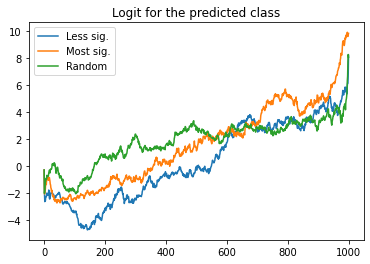

Doing item 5 of 24 with Saliency


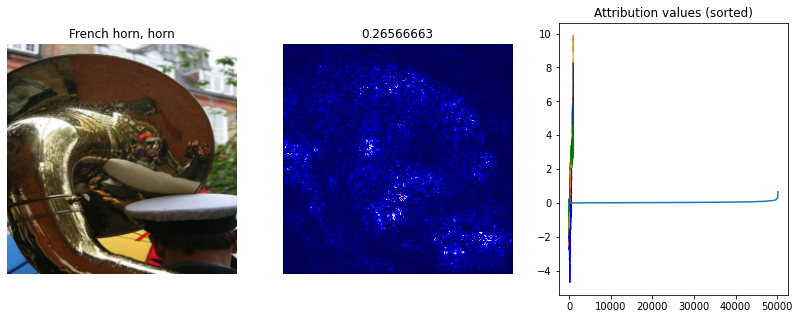

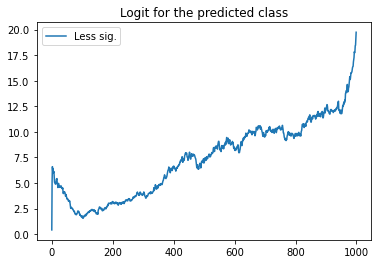

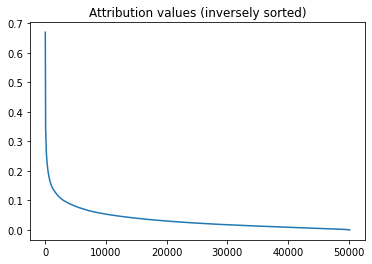

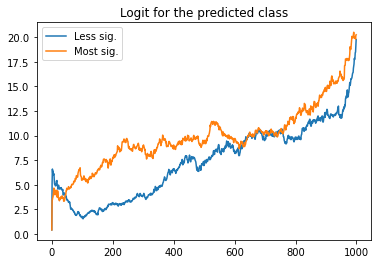

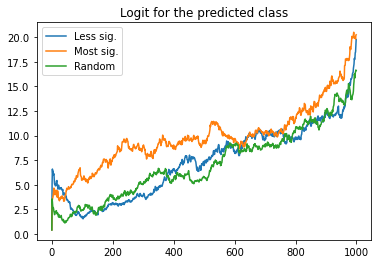

Doing item 6 of 24 with Saliency


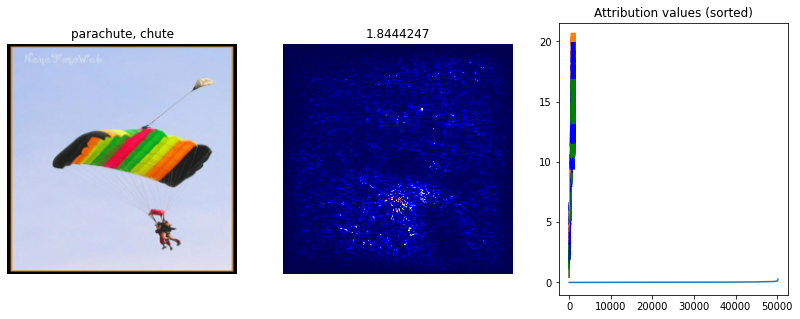

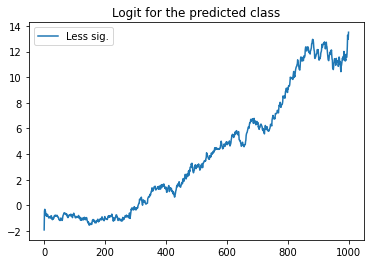

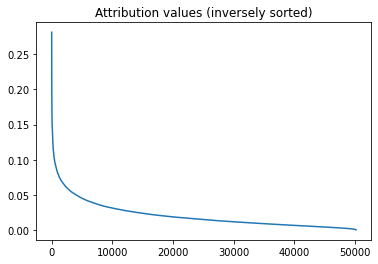

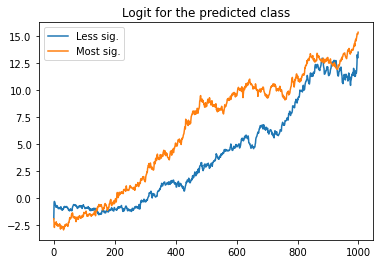

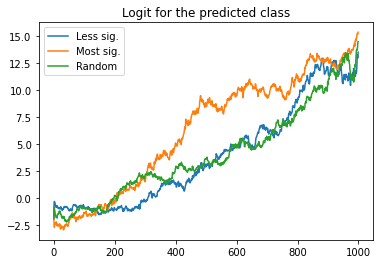

Doing item 7 of 24 with Saliency


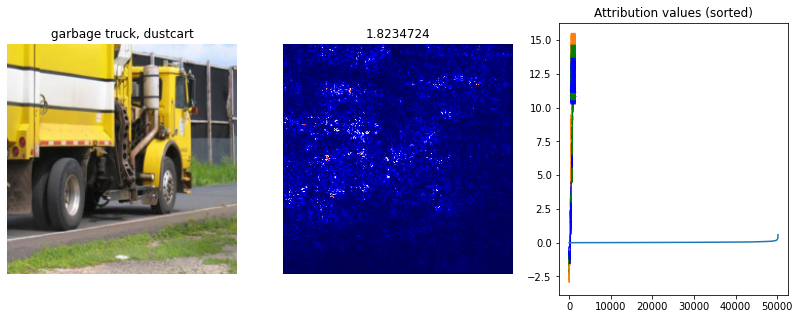

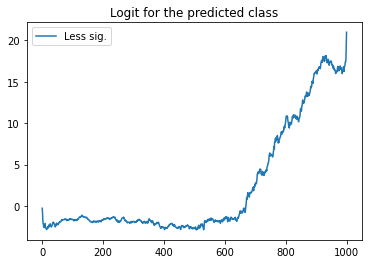

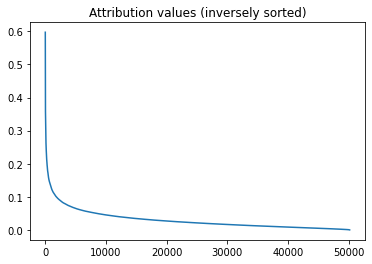

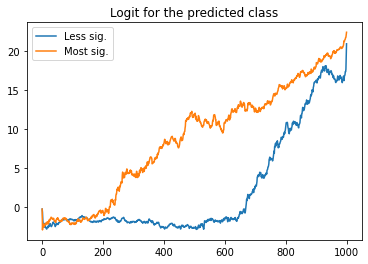

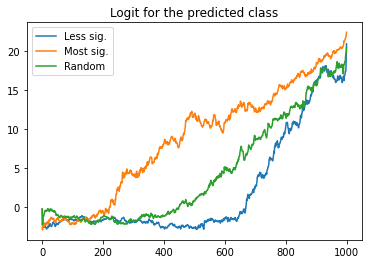

Doing item 8 of 24 with Saliency


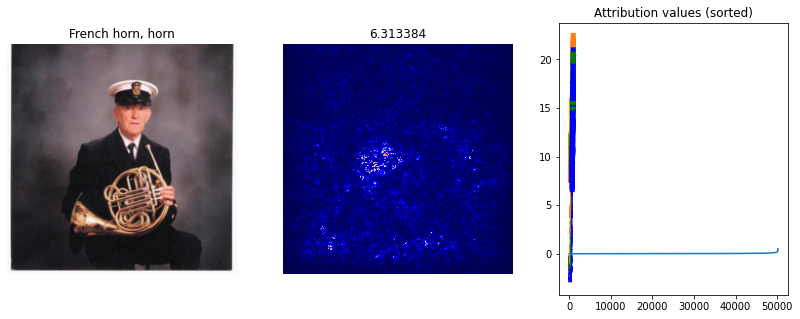

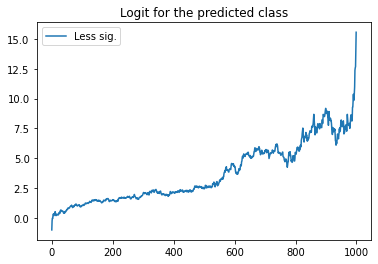

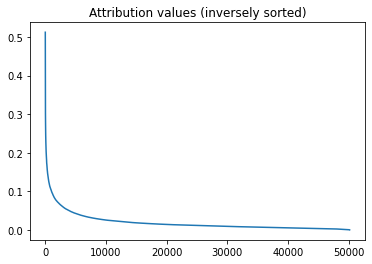

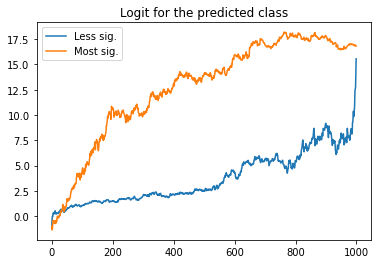

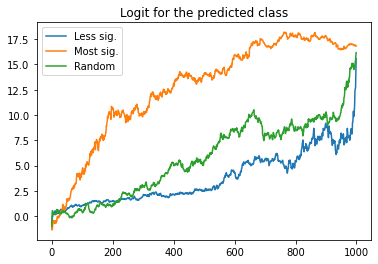

Doing item 9 of 24 with Saliency


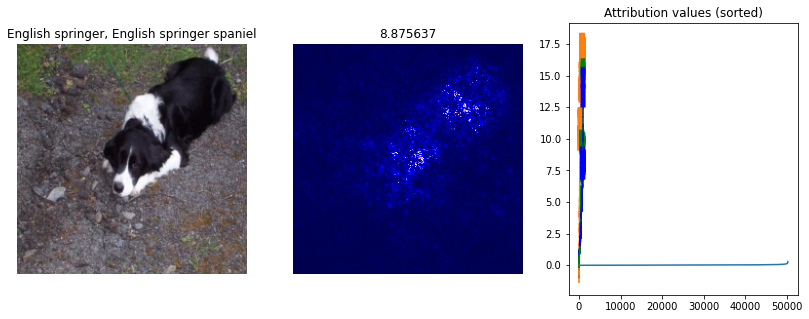

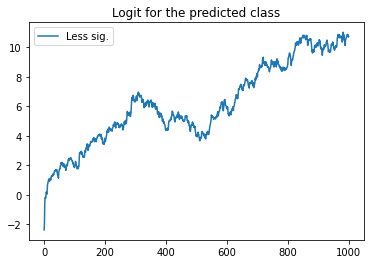

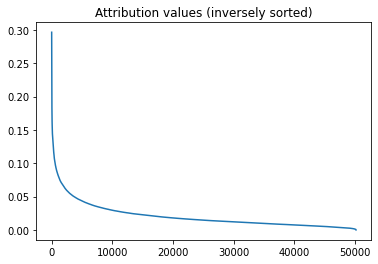

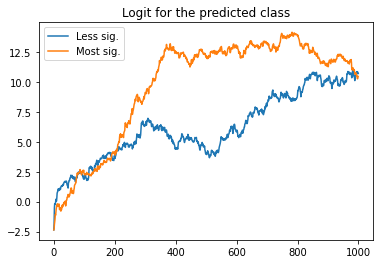

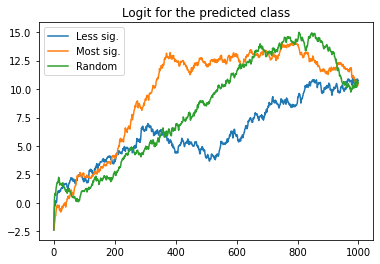

Doing item 10 of 24 with Saliency


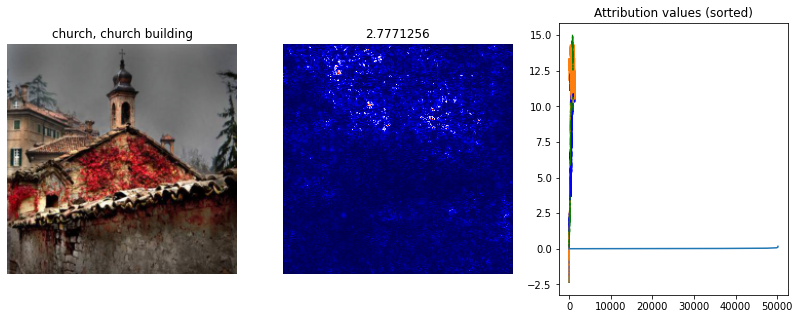

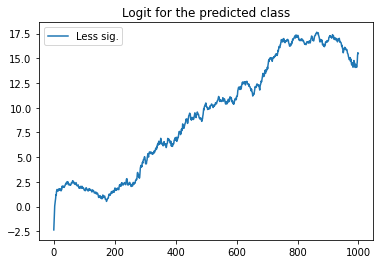

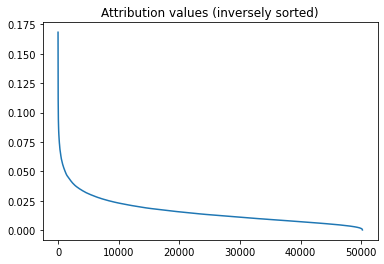

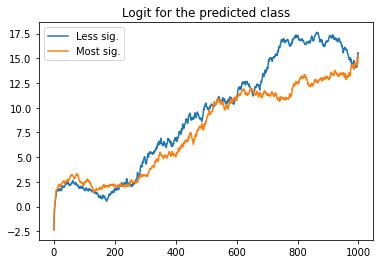

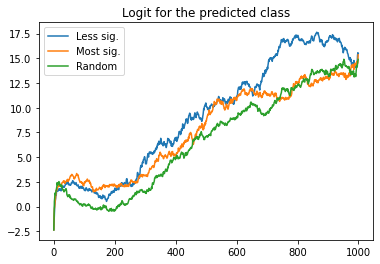

Doing item 11 of 24 with Saliency


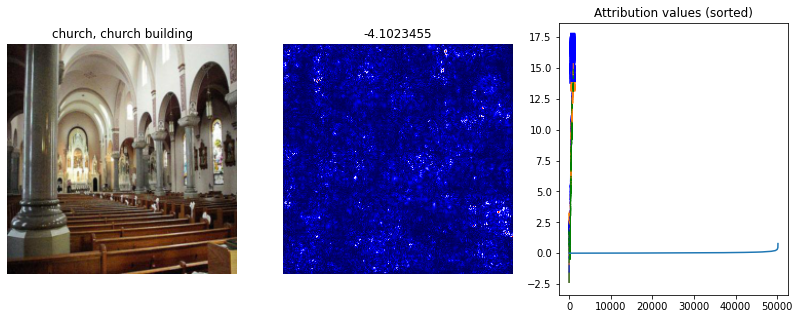

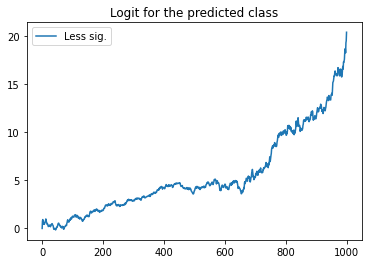

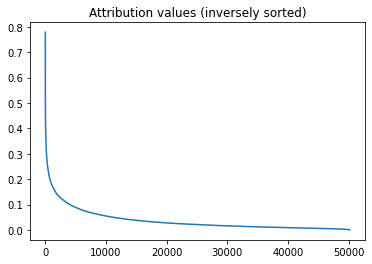

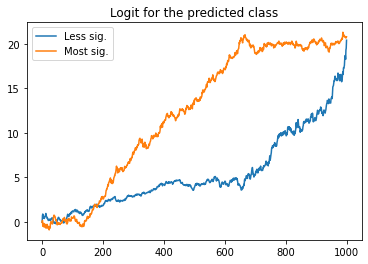

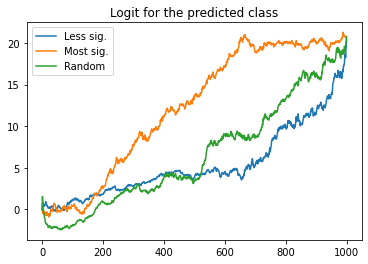

Doing item 12 of 24 with Saliency


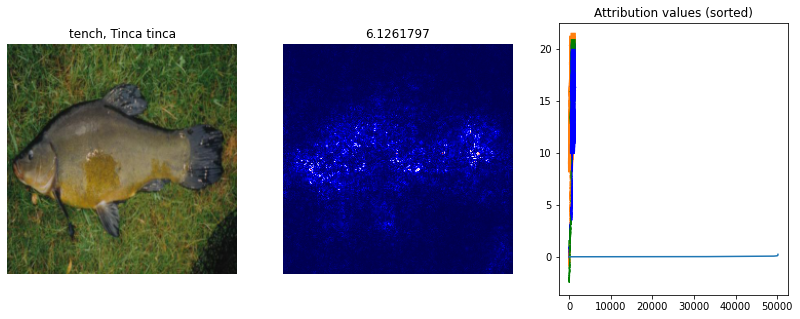

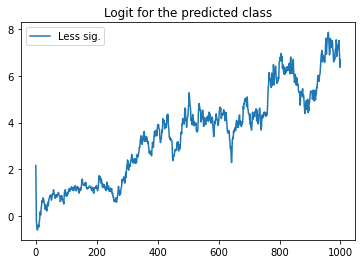

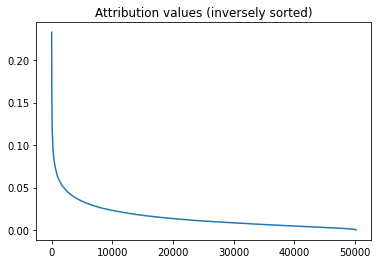

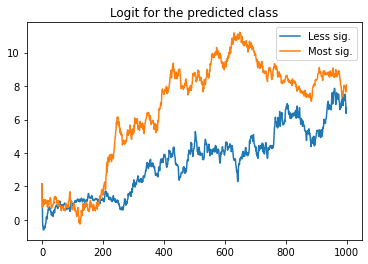

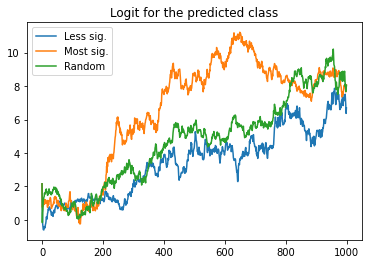

Doing item 13 of 24 with Saliency


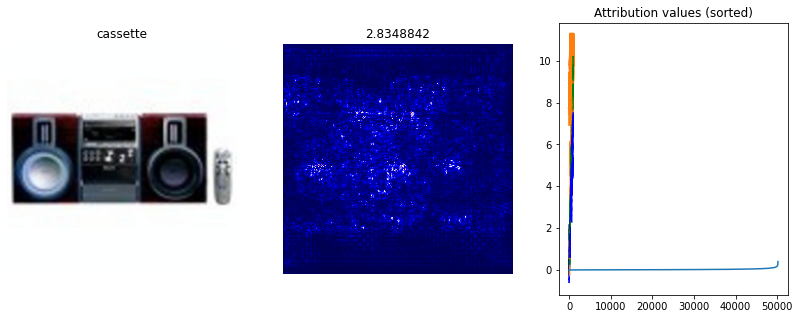

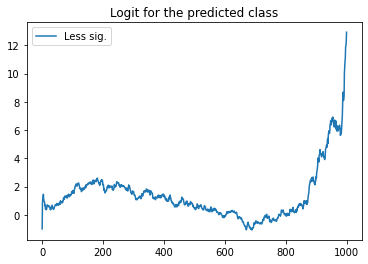

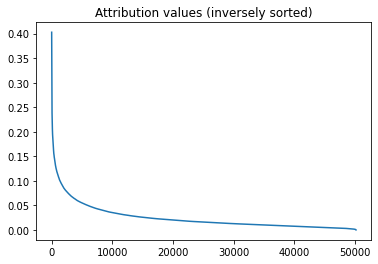

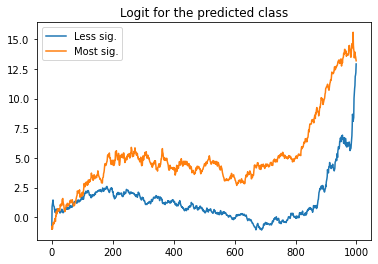

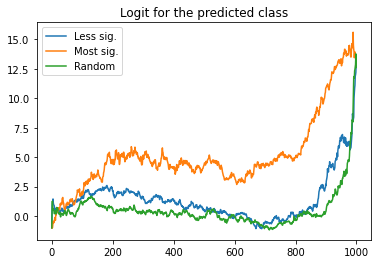

Doing item 14 of 24 with Saliency


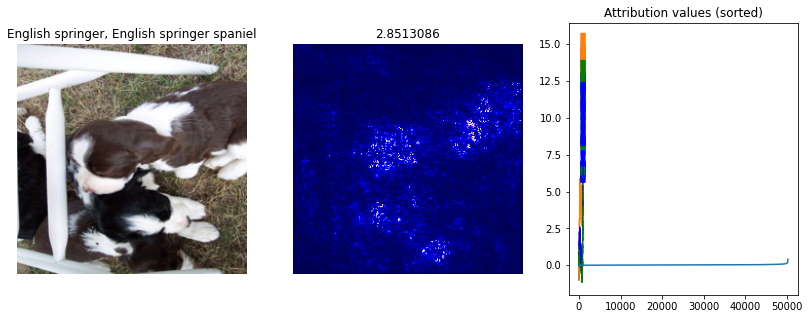

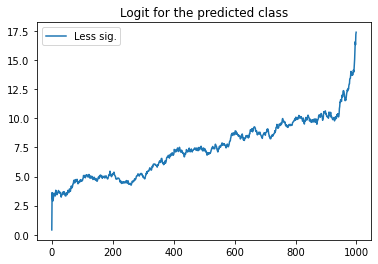

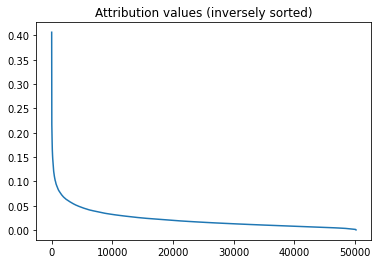

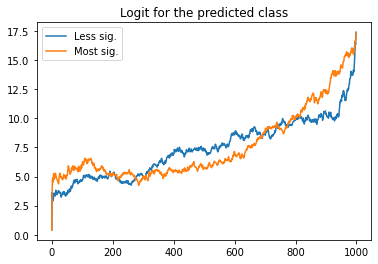

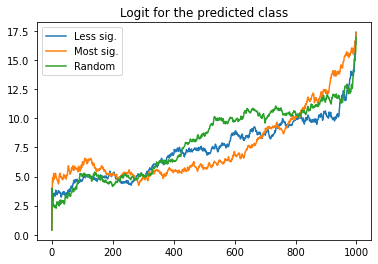

Doing item 15 of 24 with Saliency


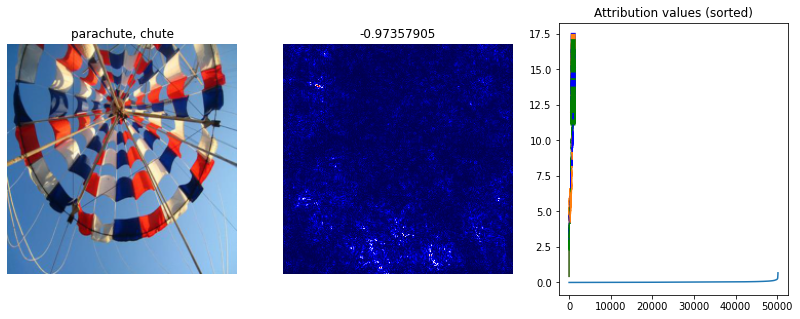

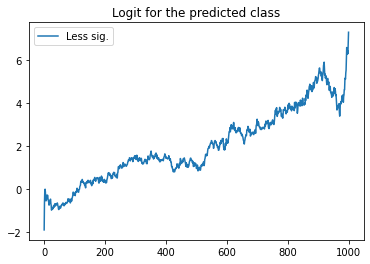

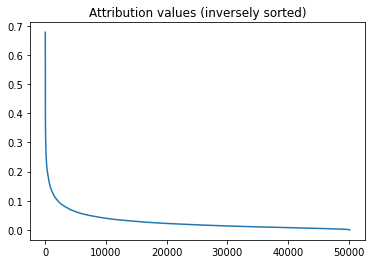

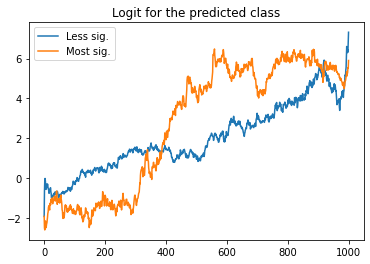

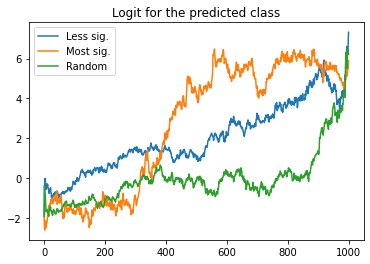

Doing item 16 of 24 with Saliency


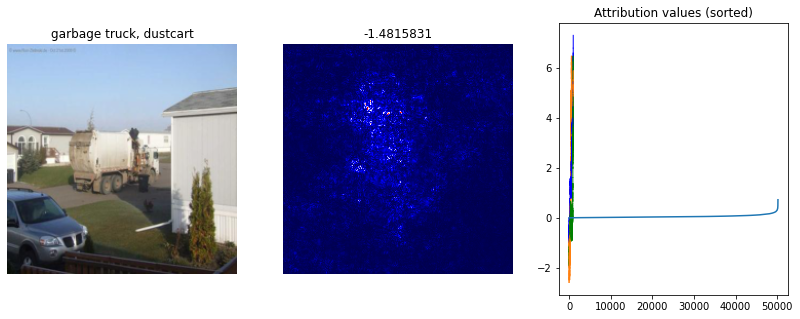

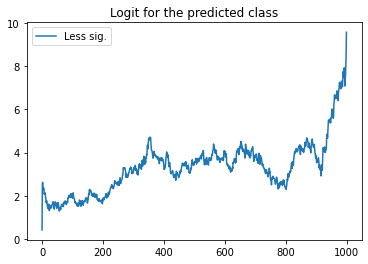

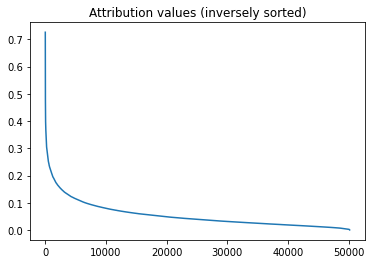

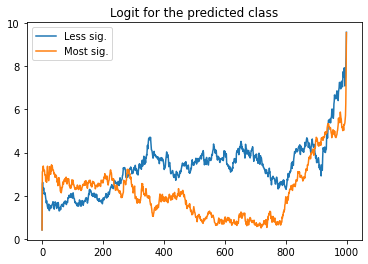

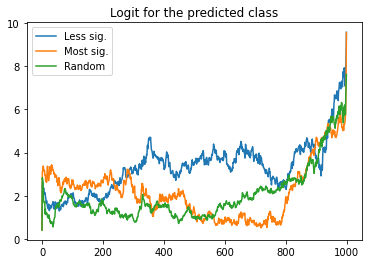

Doing item 17 of 24 with Saliency


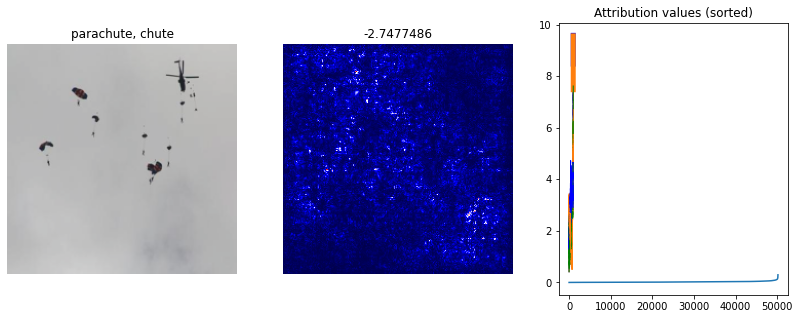

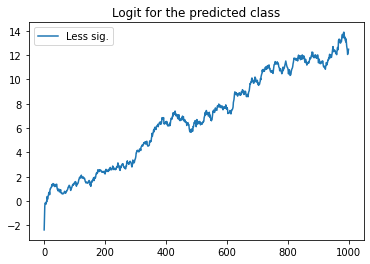

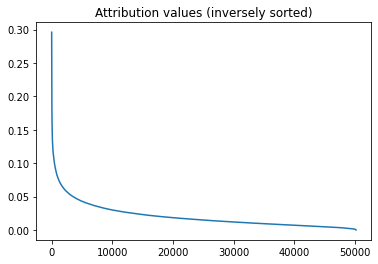

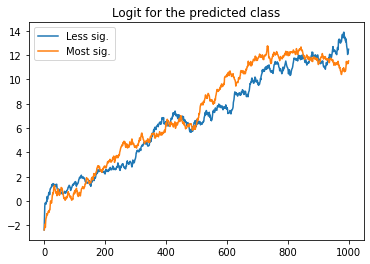

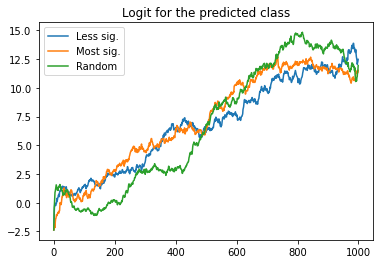

Doing item 18 of 24 with Saliency


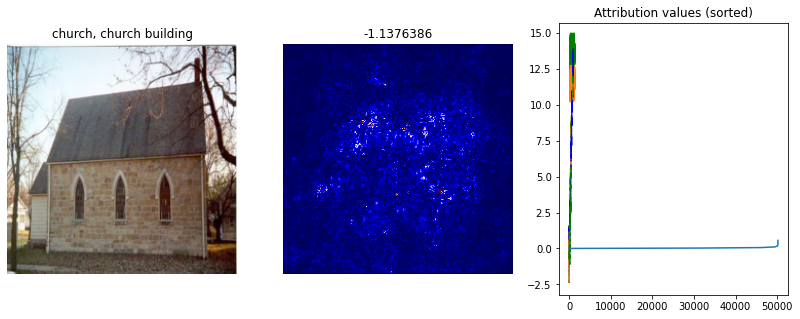

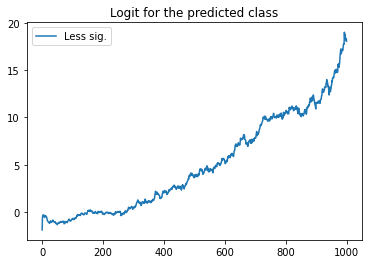

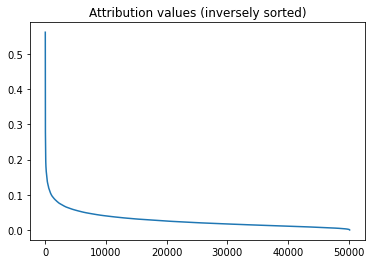

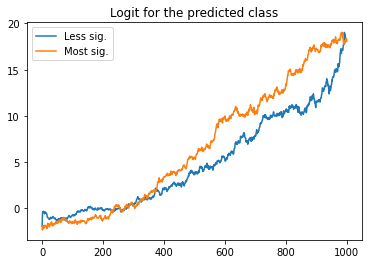

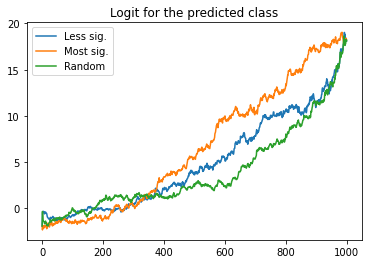

Doing item 19 of 24 with Saliency


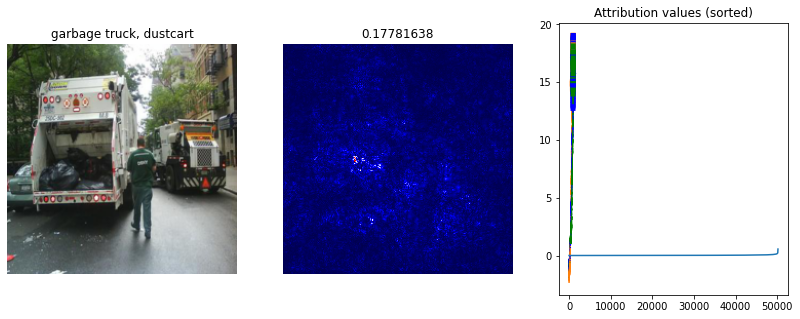

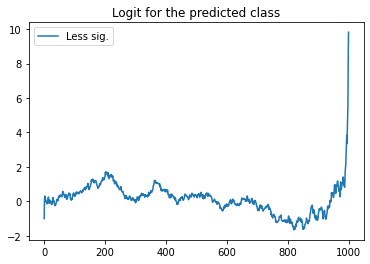

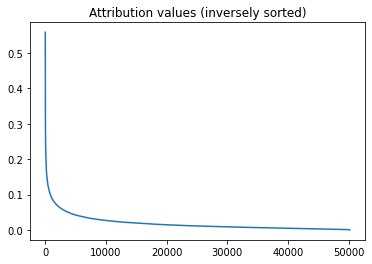

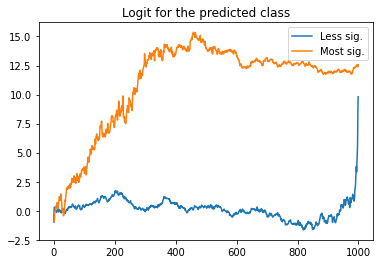

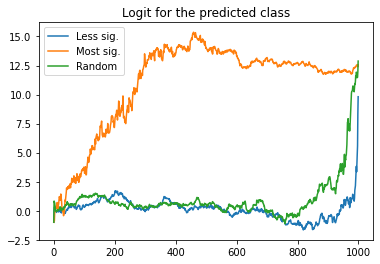

Doing item 20 of 24 with Saliency


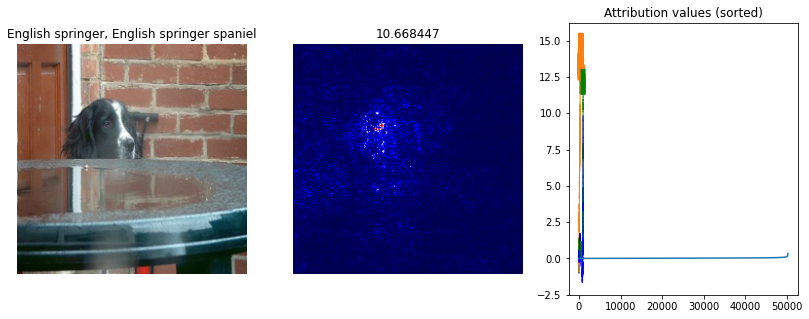

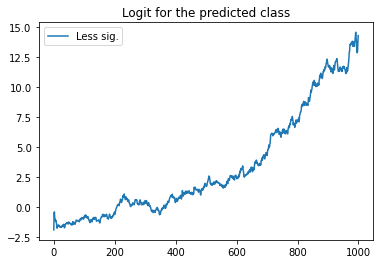

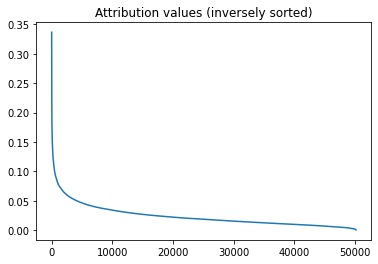

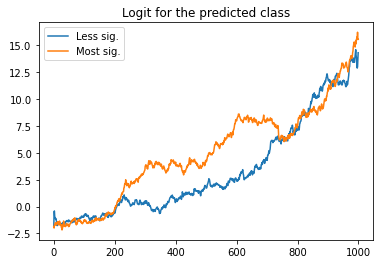

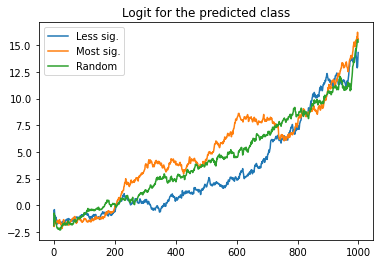

Doing item 21 of 24 with Saliency


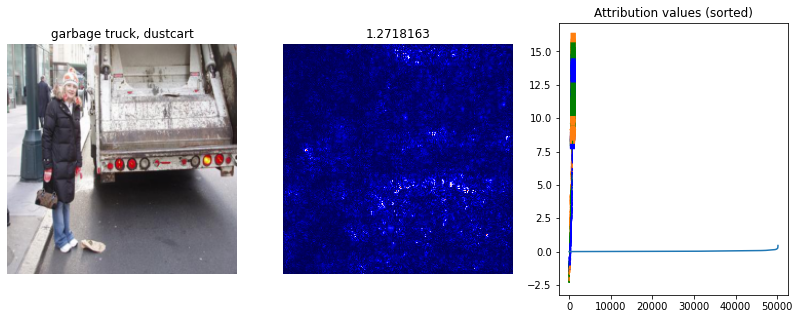

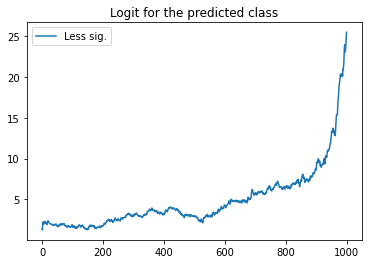

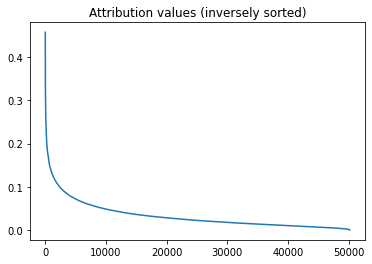

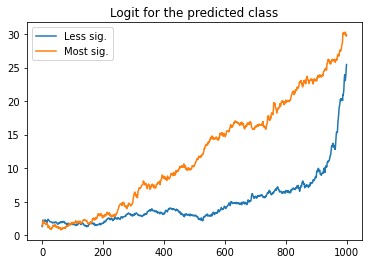

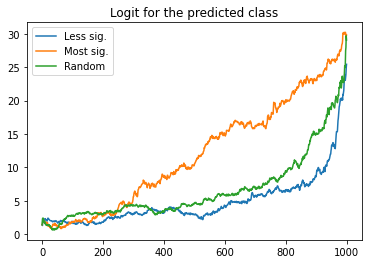

Doing item 22 of 24 with Saliency


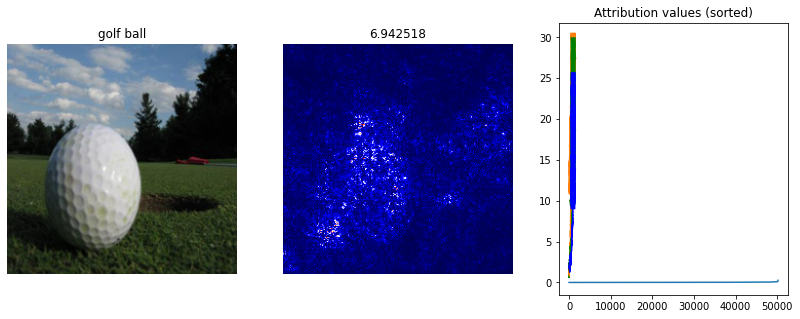

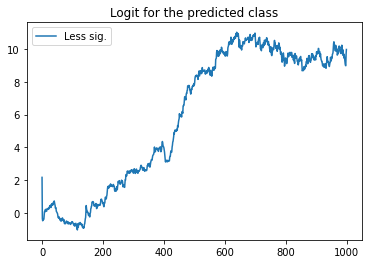

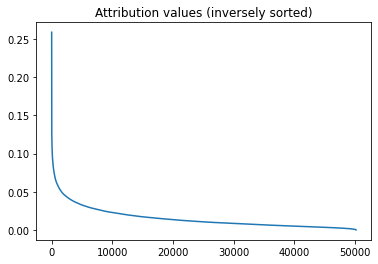

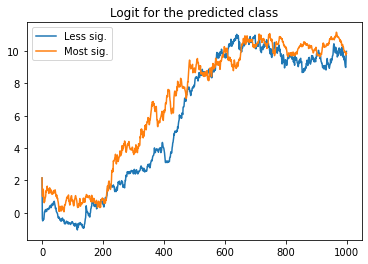

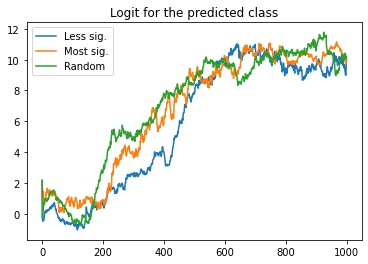

Doing item 23 of 24 with Saliency


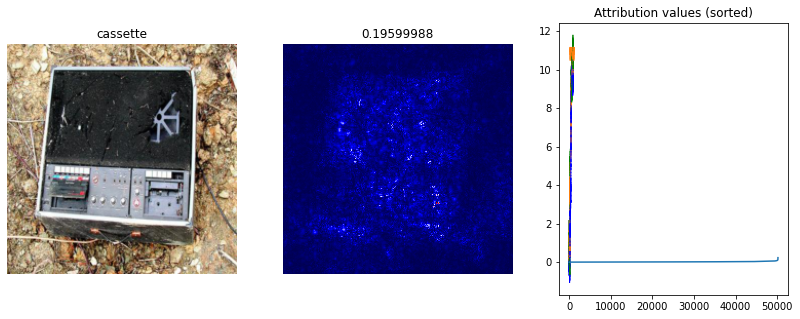

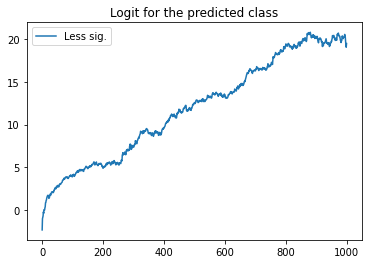

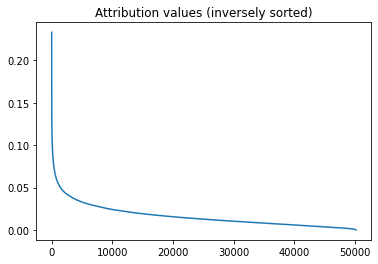

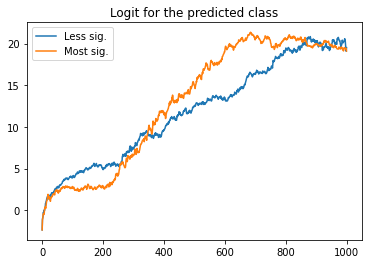

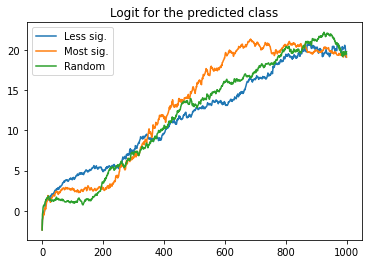

Doing item 24 of 24 with Saliency


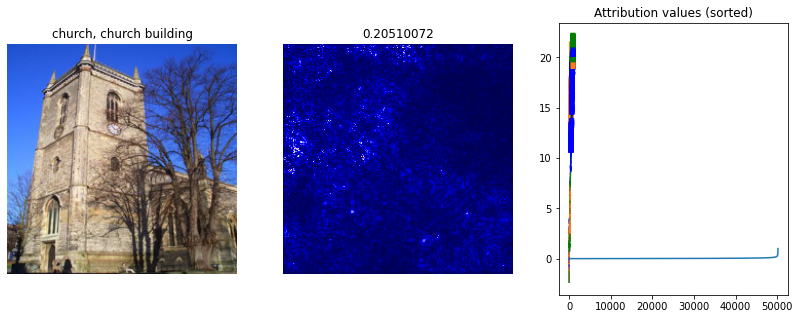

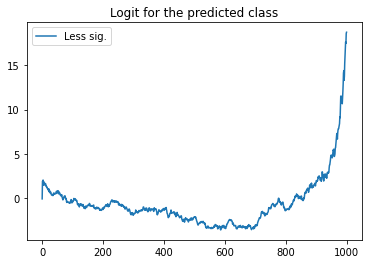

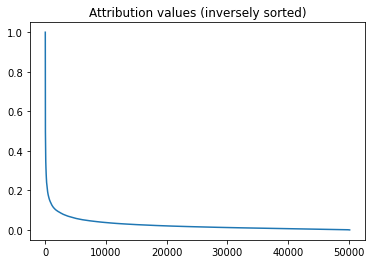

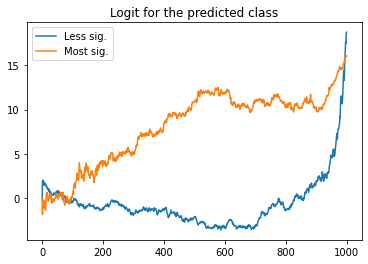

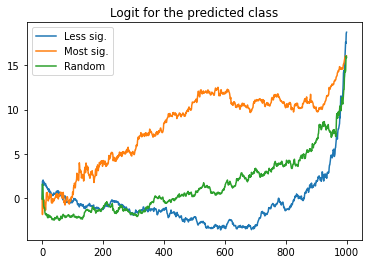

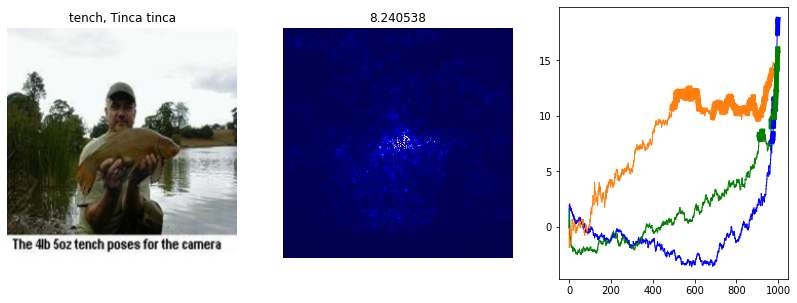

In [ ]:
#index = random.randint(0, len(x_batch)-1)
def measure_curves(ordered, inverse, random):
  return np.mean((ordered-np.maximum(random,inverse))+(np.minimum(ordered,random)-inverse))

def save_explanation_exploratory_plot(image, attributions, output_label, model, use_blurred=False, filename='unnamed'):
  if use_blurred:
    layer = get_gaussian_conv2d(kernel_size=15, sigma=10)
    alternative = layer(image) #BLURRED
  else:
    alternative = torch.from_numpy(np.full(image.shape,  0, dtype=np.float32)) #ZEROED-OUT

  # Increasing order
  ranked_atributions, positions = get_ranked_features(attributions)
  plt.plot(ranked_atributions)
  plt.title('Attribution values (sorted)')
  plt.show()

  images_masked = get_masked_images(1000, image, alternative, positions)

  class_logit,is_hit = get_class_logits_for_masked_images(images_masked, model, output_label)
  plt.plot(class_logit, label='Less sig.')
  plt.title('Logit for the predicted class')
  plt.legend()
  plt.show()

  # Decreasing order
  inversely_ranked_atributions, inversely_ranked_positions = get_ranked_features(attributions, reverse=True)
  plt.plot(inversely_ranked_atributions)
  plt.title('Attribution values (inversely sorted)')
  plt.show()

  images_masked = get_masked_images(1000, image, alternative, inversely_ranked_positions)

  class_logit_for_reverse,is_hit_for_reverse = get_class_logits_for_masked_images(images_masked, model, output_label)
  plt.plot(class_logit, label='Less sig.')
  plt.plot(class_logit_for_reverse, label='Most sig.')
  plt.title('Logit for the predicted class')
  plt.legend()
  plt.show()

  # Random order
  images_masked = get_randomly_masked_images(1000, image, alternative)

  class_logit_for_random,is_hit_for_random = get_class_logits_for_masked_images(images_masked, model, output_label)
  plt.plot(class_logit, label='Less sig.')
  plt.plot(class_logit_for_reverse, label='Most sig.')
  plt.plot(class_logit_for_random, label='Random')
  plt.title('Logit for the predicted class')
  plt.legend()
  plt.show()

  fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(14, 5))
  axes[0].imshow(np.moveaxis(quantus.denormalise(image, **{"img_size": 224}), 0, -1), vmin=0.0, vmax=1.0)
  axes[0].title.set_text(f"{class_name_dict[output_label.item()]}")
  exp = axes[1].imshow(attributions.reshape(224, 224), cmap="seismic") 
  measure = measure_curves(class_logit_for_reverse, class_logit, class_logit_for_random)
  axes[1].title.set_text(""+str(measure))
  #fig.colorbar(exp, fraction=0.03, pad=0.05); 
  axes[0].axis("off")
  axes[1].axis("off")
  for i in range(1, len(class_logit)):
    axes[2].plot([i-1,i],class_logit[i-1:i+1], lw=5 if is_hit[i] else 1, color='b')
    axes[2].plot([i-1,i],class_logit_for_reverse[i-1:i+1], lw=5 if is_hit_for_reverse[i] else 1, color='tab:orange')
    axes[2].plot([i-1,i],class_logit_for_random[i-1:i+1], lw=5 if is_hit_for_random[i] else 1, color='g')
  #axes[2].plot(class_logit, label='Less sig.')
  #axes[2].plot(class_logit_for_reverse, label='Most sig.')
  #axes[2].plot(class_logit_for_random, label='Random')
  #axes[2].legend()
  #plt.show()
  plt.savefig(f'{filename}.png')
  return measure

measure_list=[]
#for method in ['Gradient', 'GradientShap', 'InputXGradient', 'IntegratedGradients', 'Saliency']:
for method in ['IntegratedGradients', 'Saliency']:
  for i in range(len(x_batch)):
    print('Doing item',i+1,'of',len(x_batch),'with',method)
    # Generate Integrated Gradients attributions of the first batch of the test set.
    a_batch = quantus.explain(model, x_batch_device, y_batch_device, method=method, normalise=True)
    filename=f'b2-{i}-{method}-Z'
    m=save_explanation_exploratory_plot(x_batch[i], a_batch[i], y_batch[i], model, filename=filename)
    measure_list.append((m,filename))

In [ ]:
!tar zcvf images-b4.tar.gz *.png
#!rm *.png
#!pwd

b2-0-IntegratedGradients-Z.png
b2-0-Saliency-Z.png
b2-10-IntegratedGradients-Z.png
b2-10-Saliency-Z.png
b2-11-IntegratedGradients-Z.png
b2-11-Saliency-Z.png
b2-12-IntegratedGradients-Z.png
b2-12-Saliency-Z.png
b2-13-IntegratedGradients-Z.png
b2-13-Saliency-Z.png
b2-14-IntegratedGradients-Z.png
b2-14-Saliency-Z.png
b2-15-IntegratedGradients-Z.png
b2-15-Saliency-Z.png
b2-16-IntegratedGradients-Z.png
b2-16-Saliency-Z.png
b2-17-IntegratedGradients-Z.png
b2-17-Saliency-Z.png
b2-18-IntegratedGradients-Z.png
b2-18-Saliency-Z.png
b2-19-IntegratedGradients-Z.png
b2-19-Saliency-Z.png
b2-1-IntegratedGradients-Z.png
b2-1-Saliency-Z.png
b2-20-IntegratedGradients-Z.png
b2-20-Saliency-Z.png
b2-21-IntegratedGradients-Z.png
b2-21-Saliency-Z.png
b2-22-IntegratedGradients-Z.png
b2-22-Saliency-Z.png
b2-23-IntegratedGradients-Z.png
b2-23-Saliency-Z.png
b2-2-IntegratedGradients-Z.png
b2-2-Saliency-Z.png
b2-3-IntegratedGradients-Z.png
b2-3-Saliency-Z.png
b2-4-IntegratedGradients-Z.png
b2-4-Saliency-Z.png
b2-

In [ ]:
ordered_measure_list = sorted(measure_list)

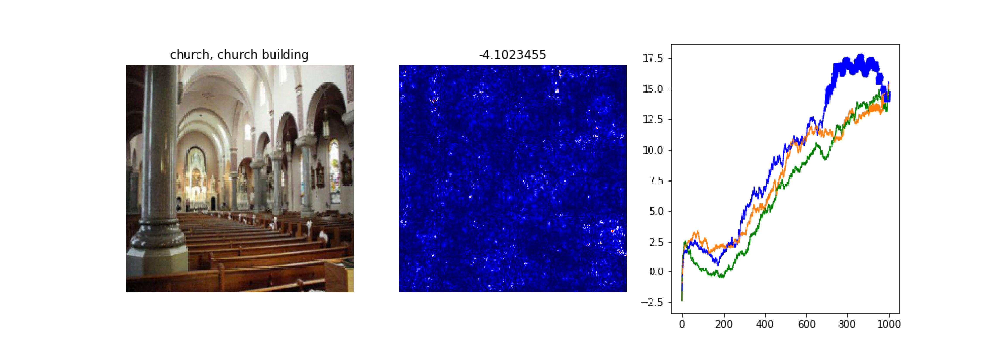

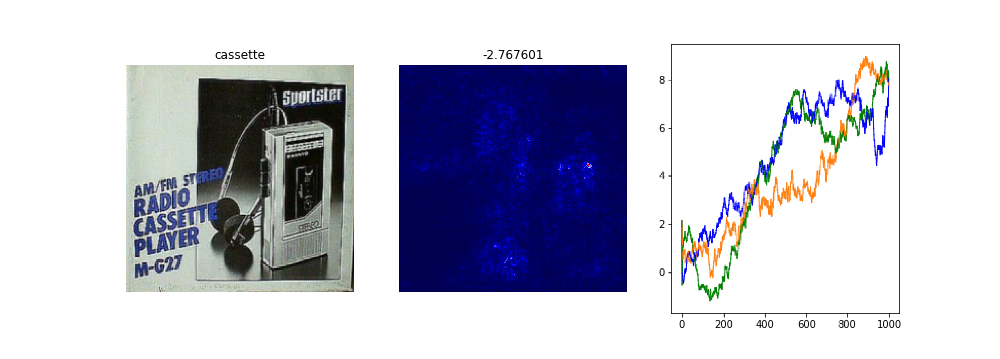

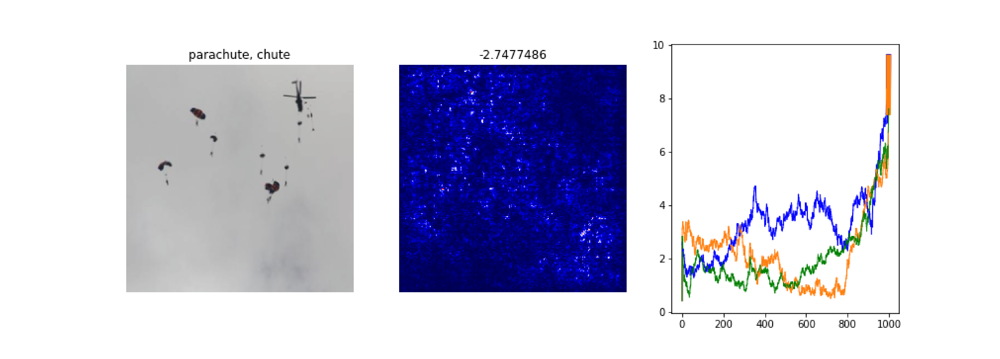

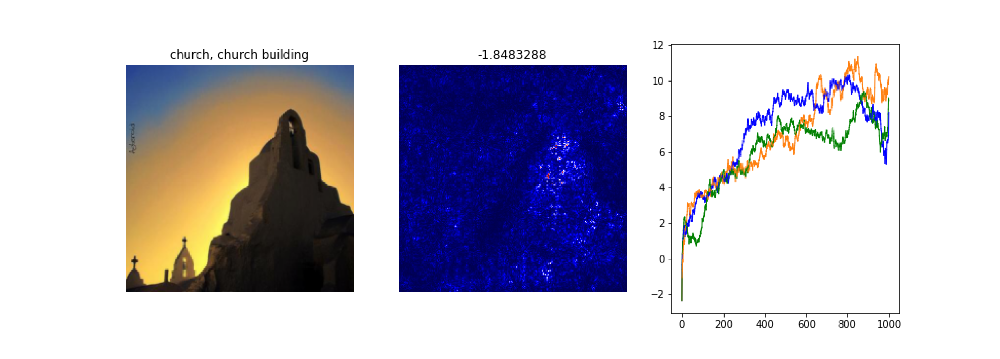

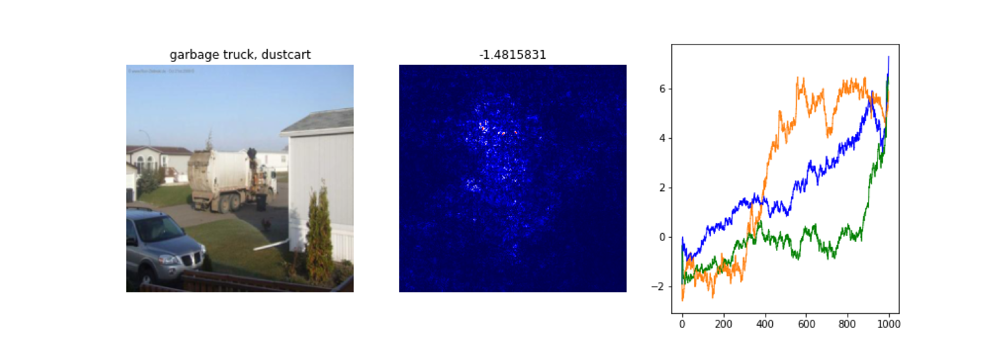

...

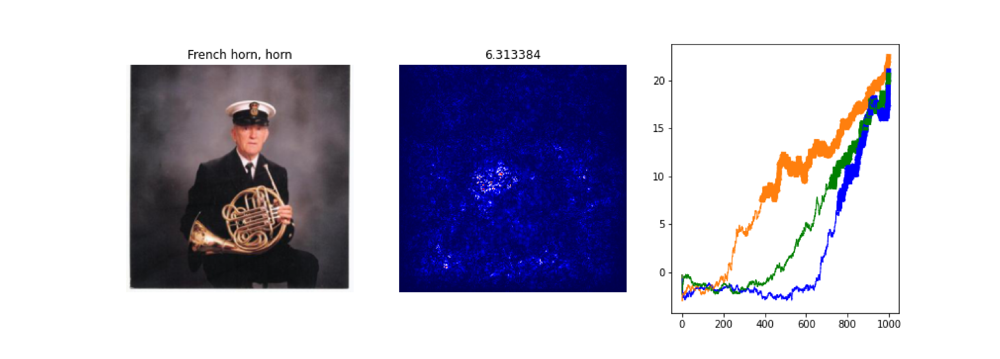

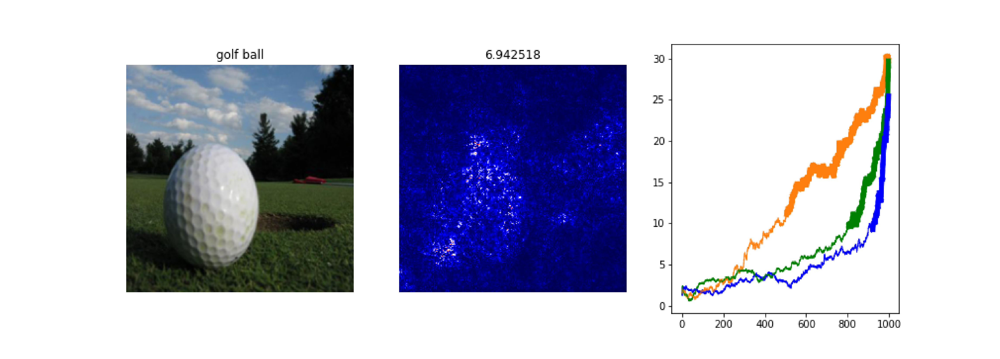

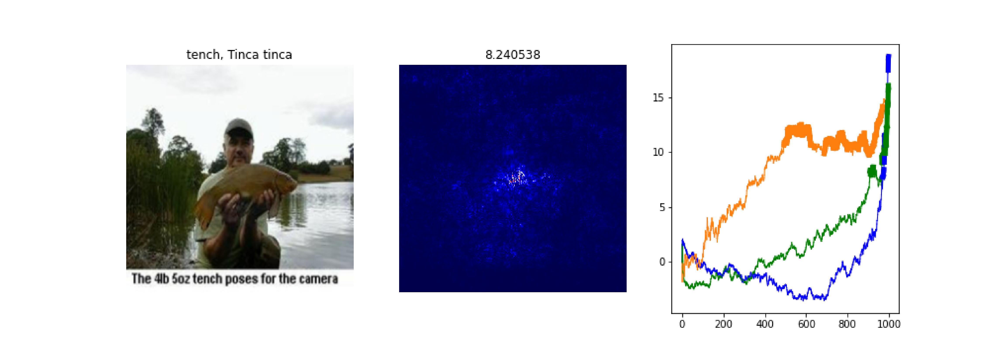

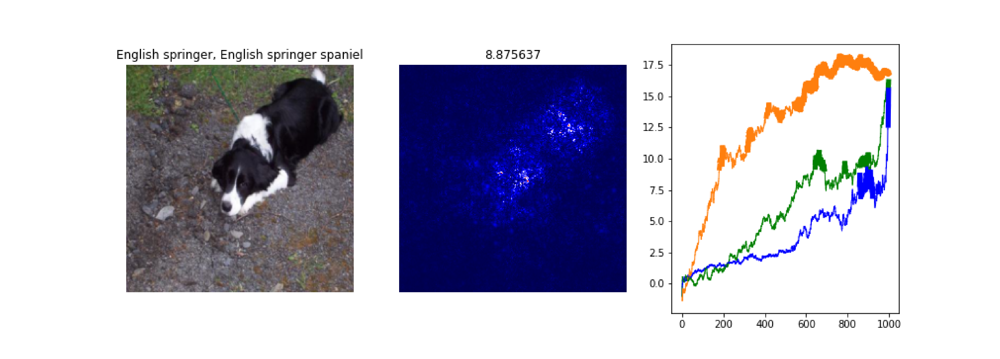

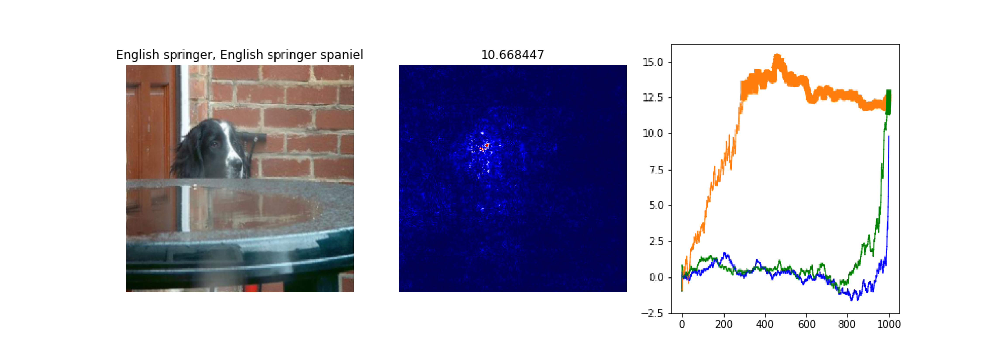

In [ ]:
import matplotlib.image as mpimg
plt.rcParams["figure.figsize"] = (200,30)
for measure,filename in ordered_measure_list:
  img = mpimg.imread(filename+".png")
  plt.imshow(img)
  plt.axis("off")
  plt.show()